In [1]:
import PIL.Image
import numpy as np
from typing import Union
from glob import glob
import os

# [IAPR][iapr]: Project


**Group ID:** 37

**Author 1 (sciper):** Elias De Smijter (366670)  
**Author 2 (sciper):** Félicie Alice Agnès Marie Giraud-Sauveur (284220)   
**Author 3 (sciper):** Cyril Felix Monette (299554)   

**Release date:** 27.04.2023


## Important notes

The assignments are designed to teach practical implementation of the topics presented during class as well as preparation for the final project, which is a practical project which ties together the topics of the course. 

As such, in the lab assignments/final project, unless otherwise specified, you may, if you choose, use external functions from image processing/ML libraries like opencv and sklearn as long as there is sufficient explanation in the lab report. For example, you do not need to implement your own edge detector, etc.

**! Before handling back the notebook !** rerun the notebook from scratch `Kernel` > `Restart & Run All`


[iapr]: https://github.com/LTS5/iapr

---
## 0. Introduction

In this project, you will be working on solving tiling puzzles using image analysis and pattern recognition techniques. Tiling puzzles are a classic type of puzzle game that consists of fitting together pieces of a given shape (in this case squared to form a complete image. The goal of this project is to develop an algorithm that can automatically reconstruct tiling puzzles from a single input image. 

---

## 1. Data

### Input data
To achieve your task, you will be given images that look like this:


![train_00.png](data_project/project_description/train_00.png)

### Example puzzle content
Example of input of solved puzzles. 
Solution 1
<img src="data_project/project_description/solution_example.png" width="512"/>
Solution 2
<img src="data_project/project_description/solution_example2.jpg" width="512"/>


### 1.1. Image layout

- The input for the program will be a single image with a size of __2000x2000 pixels__, containing the pieces of the tiling puzzles randomly placed in it. The puzzles sizes vary from __3x3, 3x4, or 4x4__ size. 
    -__You are guaranteed to always have the exact number of pieces for each puzzle__ 
        -For each puzzle you always are expected to find exaclty 9,12,16 pieces
        -If you find something else, either you are missing pieces, or added incorrect pieces for the puzzle

- The puzzle pieces are square-shaped with dimensions of 128x128 pixels (before rotation). 

- The input image will contain pieces from __two or three (but never four)__ different tiling puzzles, as well as some __extra pieces (outliers)__ that do not belong to either puzzle.


## 2. Tasks (Total 20 points) 


The project aims to:
1) Segment the puzzle pieces from the background (recover the pieces of 128x128 pixels)   \[ __5 points__ \] 

2) Extract features of interest from puzzle pieces images \[ __5 points__ \]   

3) Cluster puzzle pieces to identify which puzzle they belong, and identify outliers.  \[ __5 points__ \]   

4) Solve tiling puzzle (find the rotations and translations to correctly allocate the puzzle pieces in a 3x3, 3x4 or 4x4 array.) \[ __5 points__ \]   

##### The images used for the puzzles have self-repeating patterns or textures, which ensures that all puzzle pieces contain more or less the same features regardless of how they were cut. 




### 1.2. Output solution pieces.

For each inpute image, the output solution will include N images with solved puzzles, where N is the number of puzzles in the input image. and M images, that are Each of these images will contain the solved solution to one of the N puzzles in the input. 


-  Example input:  train_05.png

- Example solution:
        -solution_05_00.png solution_05_01.png solution_05_02.png 
        -outlier_05_00.png outlier_05_01.png outlier_05_02.png ...

- Example input:  train_07.png
- Example solution:
        -solution_07_00.png solution_07_01.png 
        -outlier_07_00.png outlier_07_01.png outlier_07_02.png ...


__Watch out!__ output resolution should always be like this:  
<table ><tr><th >Puzzle pieces <th><th> pixel dimentions <th> <th> pixel dimentions <th> <tr>
<tr><td> 3x3 <td><td> 384x384 <td><td> 3(128)x3(128) <td> <tr>
<tr><td> 3x4 <td><td> 384x512 <td><td> 3(128)x4(128)<tr>
<tr><td> 4x4 <td><td> 512x512 <td><td> 4(128)x4(128)<tr>
<tr><td> 1x1 (outlier)<td><td> 128x128 <td><td> (1)128x(1)128 <td><tr><table>





__Order of the solutions (and rotations) it's not a problem for the grading__




the output solution will be a final image of resolution (1283)x(1283), with each piece correctly placed in its corresponding location in the 3x3 array. Similarly, if the puzzle consists of 3x4 or 4x4 pieces, the output solution will be an image of resolution (1283)x(1284) or (1284)x(1284)



### 1.3 Data folder Structure

You can download the data for the project here: [download data](https://drive.google.com/drive/folders/1k3xTH0ZhpqZb3xcZ6wsOSjLzxBNYabg3?usp=share_link)

```
data_project
│
└─── project_description
│    │    example_input.png      # example input images
│    │    example_textures1.png      # example input images
│    │    example_textures2.png      # example input images
│    └─── ultimate_test.jpg   # If it works on that image, you would probably end up with a good score
│
└─── train
│    │    train_00.png        # Train image 00
│    │    ...
│    │    train_16.png        # Train image 16
│    └─── train_labels.csv    # Ground truth of the train set
|    
└────train_solution
│    │    solution_00_00.png        # Solution puzzle 1 from Train image 00
│    │    solution_00_01.png        # Solution puzzle 2 from Train image 00
│    │    solution_00_02.png        # Solution Puzzle 3 from Train image 00
│    │    outlier_00_00.png         # outlier     from Train image 00
│    │    outlier_00_01.png         # outlier     from Train image 00
│    │    outlier_00_03.png         # outlier     from Train image 00
│    │    ...
│    │    solution_15_00.png        # Solution puzzle 1 from Train image 15
│    │    solution_15_01.png        # Solution puzzle 2 from Train image 15
│    │    outlier_15_00.png         # outlier     from Train image 15
│    └─── outlier_15_01.png         # outlier     from Train image 15
│
└─── test
     │    test_00.png         # Test image 00 (day of the exam only)
     │    ...
     └─── test_xx.png             # Test image xx (day of the exam only)
```



## 3. Evaluation

**Before the exam**
   - Create a zipped folder named **groupid_xx.zip** that you upload on moodle (xx being your group number).
   - Include a **runnable** code (Jupyter Notebook and external files) and your presentation in the zip folder.
   
**The day of the exam**
   - You will be given a **new folder** (test folder) with few images, but **no ground truth** (no solutions).
   - We will ask you to run your pipeline in **real time** and to send us your prediction of the task you obtain with the provided function **save_results**. 
   - On our side, we will compute the performance of your classification algorithm. 
   - To evaluate your method, we will use the **evaluate_solution** function presented below. To understand how the provided functions work, please read the documentation of the functions in **utils.py**.
   - **Please make sure your function returns the proper data format to avoid points penalty on the day of the exam**. 
---


## 4. Your code

### 4.1. Setup

In [2]:
# Mount drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# Import
import os 
import sys
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import cv2
import torch

In [4]:
# Path folder
ROOT_PATH = "/content/drive/MyDrive/Colab_Notebooks/ImAn_EPFL"
print(os.listdir(ROOT_PATH))

['data_project', '__pycache__', 'rotated_rect_crop.py', 'project_colab.ipynb']


In [ ]:
# Load images

def load_input_image(image_index ,  folder ="train" , path = ROOT_PATH+"/data_project"):
    
    filename = "train_{}.png".format(str(image_index).zfill(2))
    path_solution = os.path.join(path,folder , filename )
    
    im= Image.open(os.path.join(path,folder,filename)).convert('RGB')
    im = np.array(im)
    return im

### 4.2. Segmentation

In [ ]:
# Check GPU
!nvidia-smi

Fri May 19 07:35:42 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   62C    P0    28W /  70W |  10389MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
# Install Segment Anything Model (SAM) and other dependencies

HOME = os.getcwd()
%cd {HOME}
!{sys.executable} -m pip install 'git+https://github.com/facebookresearch/segment-anything.git'
!pip install -q jupyter_bbox_widget roboflow dataclasses-json supervision

# Download SAM weights

%cd {HOME}
!mkdir {HOME}/weights
%cd {HOME}/weights
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth

CHECKPOINT_PATH = os.path.join(HOME, "weights", "sam_vit_h_4b8939.pth")
print(CHECKPOINT_PATH, "; exist:", os.path.isfile(CHECKPOINT_PATH))

/content/weights
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-fi6mzqlf
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-fi6mzqlf
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 6fdee8f2727f4506cfbbe553e23b895e27956588
  Preparing metadata (setup.py) ... done
/content/weights
/content/weights/weights
/content/weights/weights/sam_vit_h_4b8939.pth ; exist: True


In [ ]:
# Load SAM Model

DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
MODEL_TYPE = "vit_h"

from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor

sam = sam_model_registry[MODEL_TYPE](checkpoint=CHECKPOINT_PATH).to(device=DEVICE)

In [ ]:
# Generate masks generator with SAM

mask_generator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=32,
    pred_iou_thresh=0.95,
    stability_score_thresh=0.92,
    crop_n_layers=1,
    crop_n_points_downscale_factor=2,
    min_mask_region_area=15000,  # Requires open-cv to run post-processing
)

In [ ]:
# Function to visualize sam_results with Supervision

import supervision as sv

def see_segmentation(image_bgr, sam_result):

  mask_annotator = sv.MaskAnnotator()

  detections = sv.Detections.from_sam(sam_result=sam_result)

  annotated_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)

  sv.plot_images_grid(
      images=[image_bgr, annotated_image],
      grid_size=(1, 2),
      titles=['source image', 'segmented image']
  )

In [ ]:
# Import function to rotate rectangle and crop into a new image

%load_ext autoreload
%autoreload 2

sys.path.append(ROOT_PATH)
from rotated_rect_crop import crop_rotated_rectangle

# image is the image matrix
# rect is the rotated rect object in OpenCV, i.e. (center (x,y), (width, height), angle of clock-wise rotation)
# center x is regarding to the width
# center y is regarding to the height
# width is the number of the columns of the rectangle.
# height is the number of the rows of the rectangle.
# The angle vector pointing to the "north" is exactly 0 degre

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


###########################################################################
############################# Image 00 ####################################
###########################################################################

------------ 1. Sam_result ------------



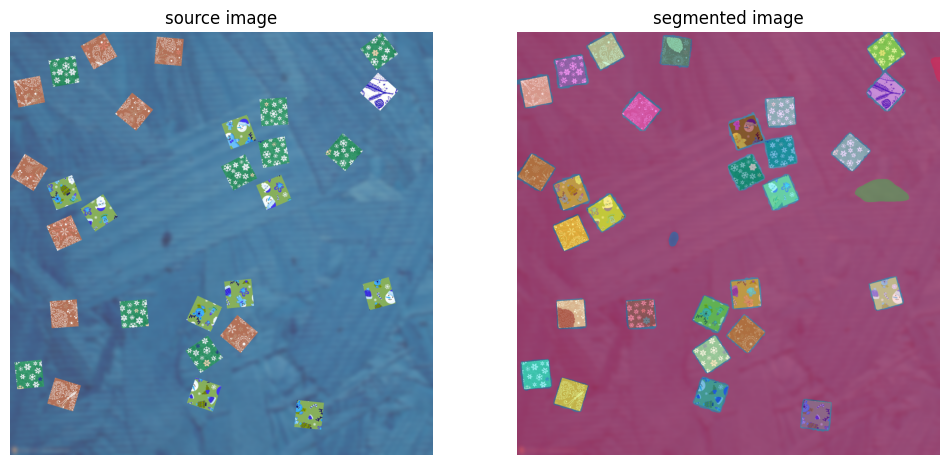


--------------- 2. Masks ---------------



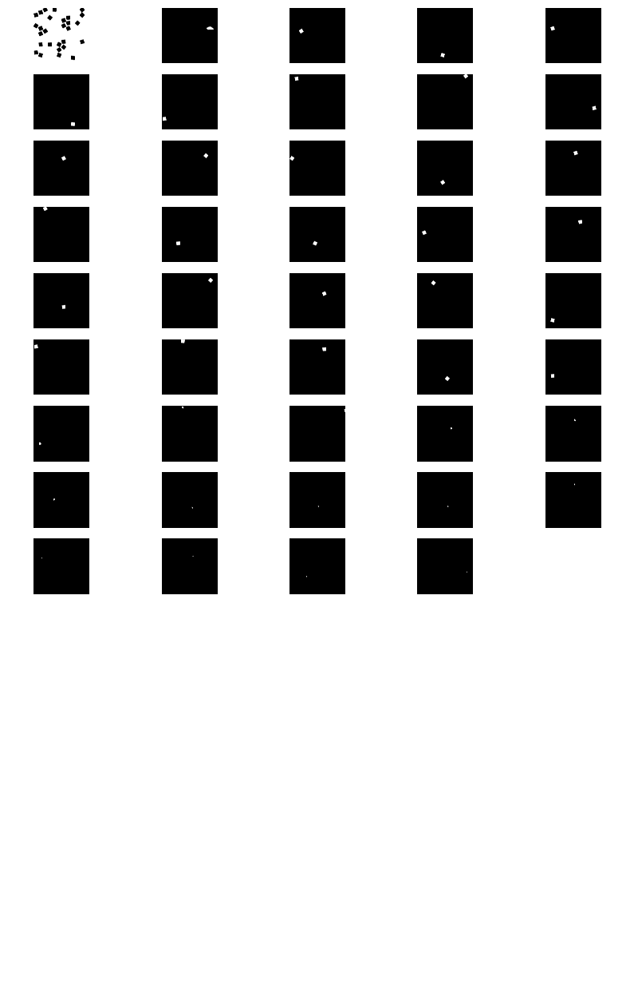


------------- 3. Best mask -------------

best_mask saved! 
 

###########################################################################
############################# Image 01 ####################################
###########################################################################

------------ 1. Sam_result ------------



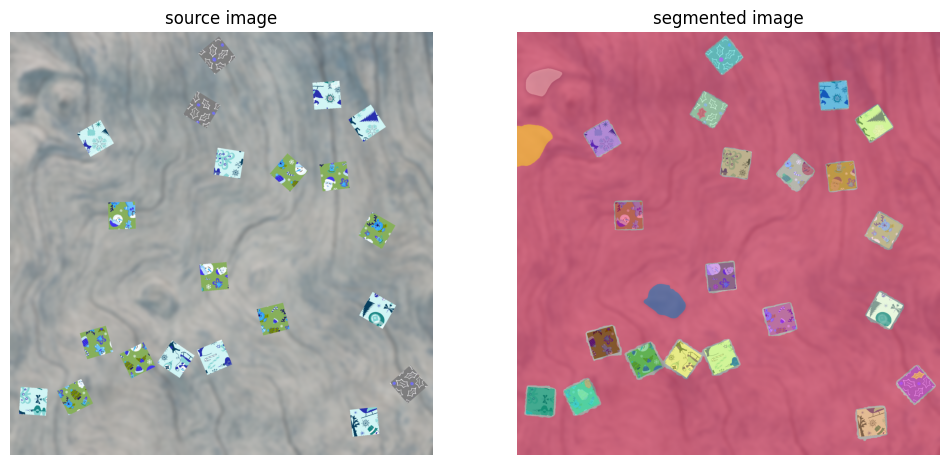


--------------- 2. Masks ---------------



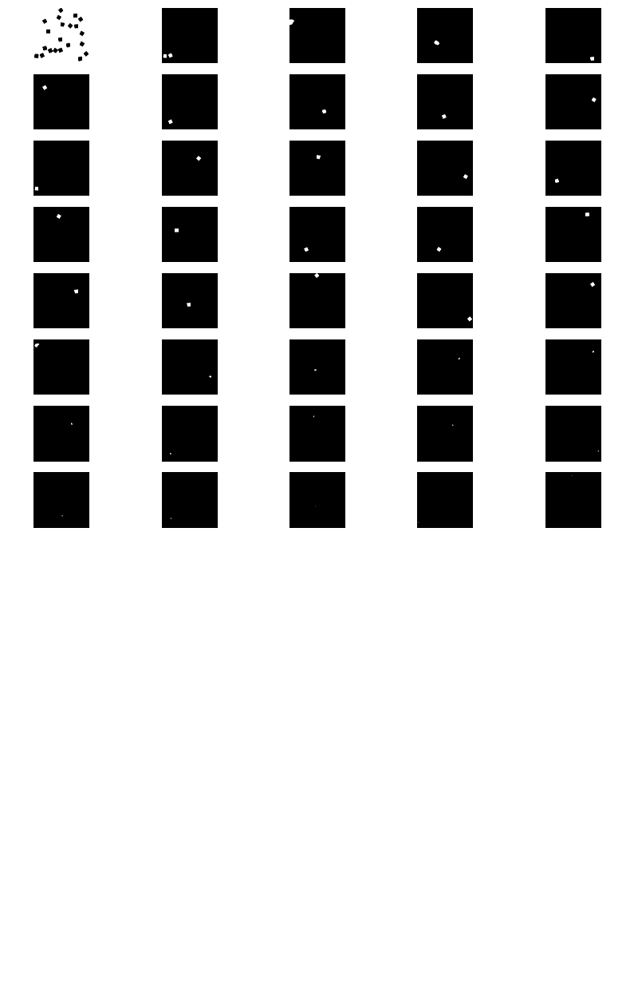


------------- 3. Best mask -------------

best_mask saved! 
 

###########################################################################
############################# Image 02 ####################################
###########################################################################

------------ 1. Sam_result ------------



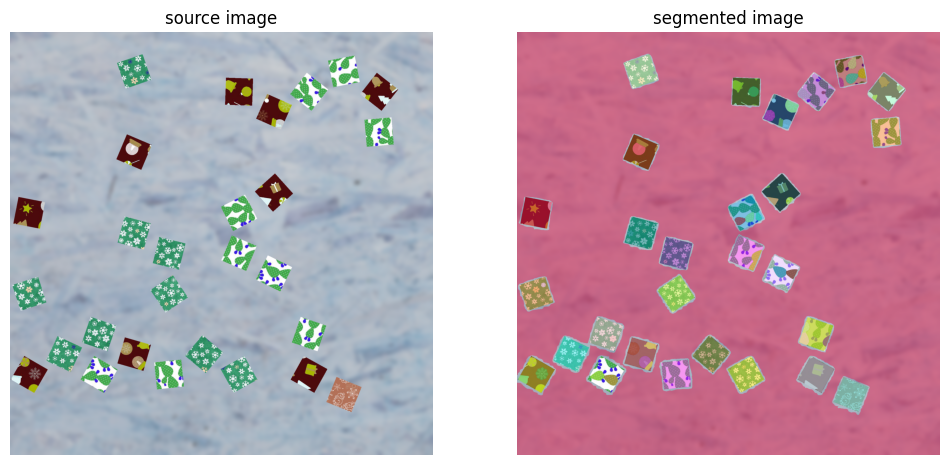


--------------- 2. Masks ---------------



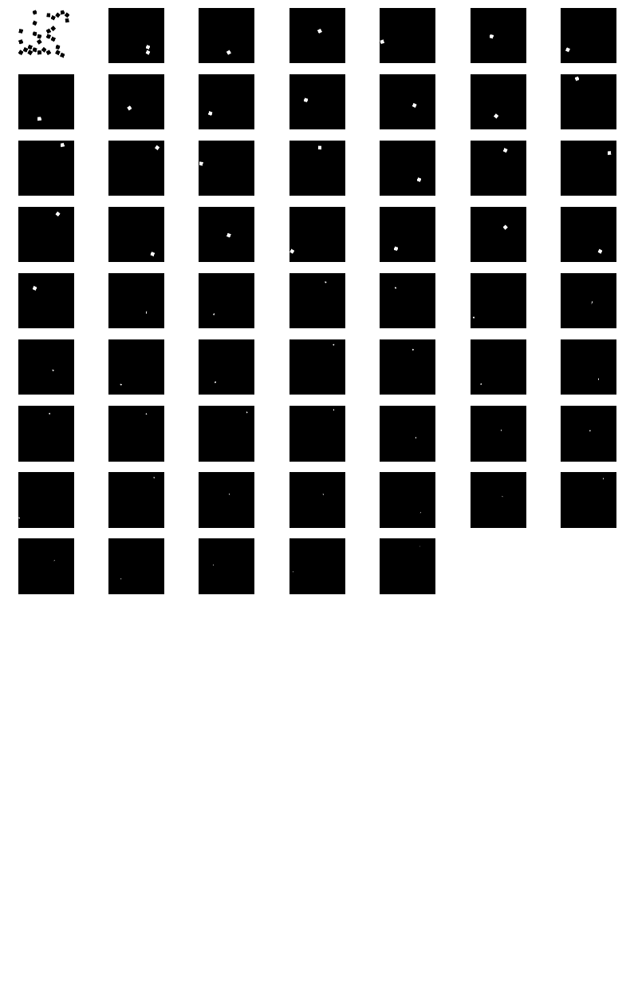


------------- 3. Best mask -------------

best_mask saved! 
 

###########################################################################
############################# Image 03 ####################################
###########################################################################

------------ 1. Sam_result ------------



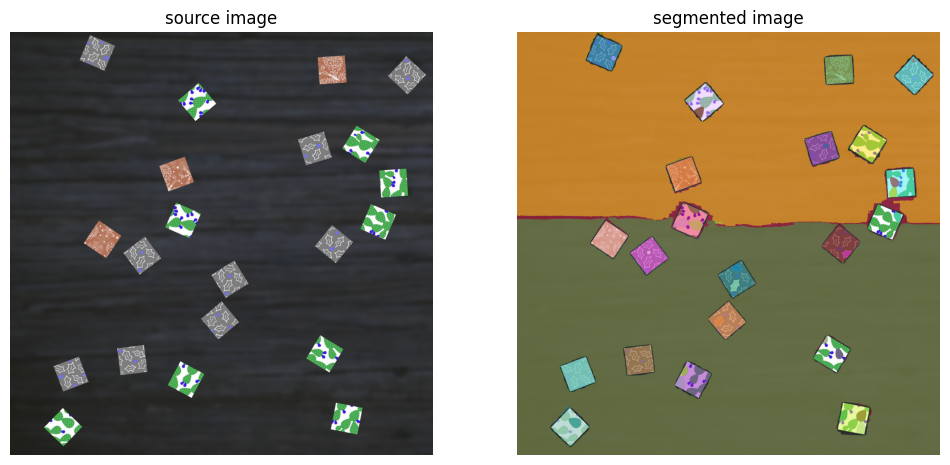


--------------- 2. Masks ---------------



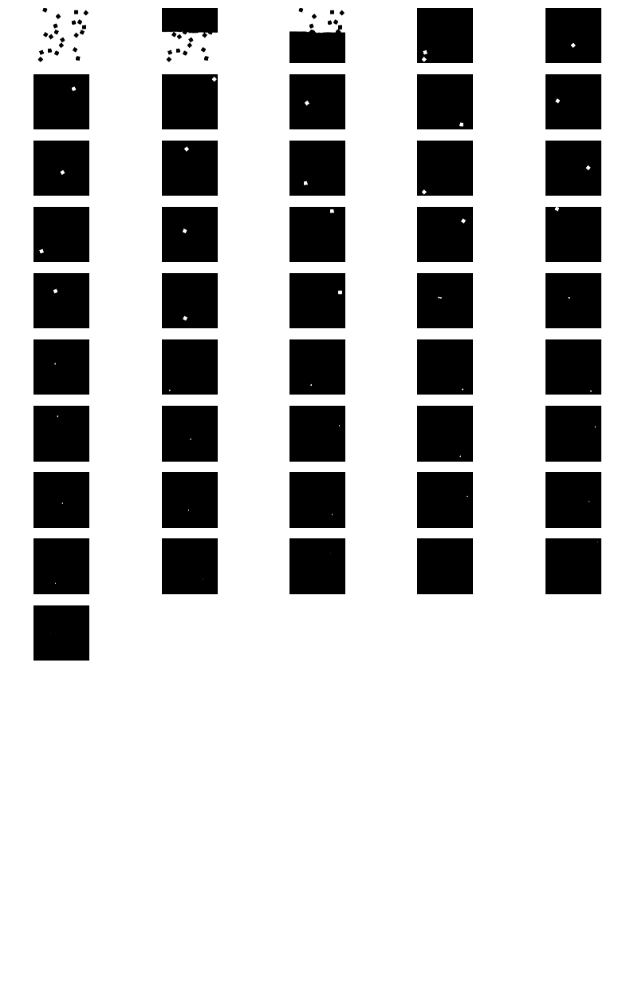


------------- 3. Best mask -------------

best_mask saved! 
 

###########################################################################
############################# Image 04 ####################################
###########################################################################

------------ 1. Sam_result ------------



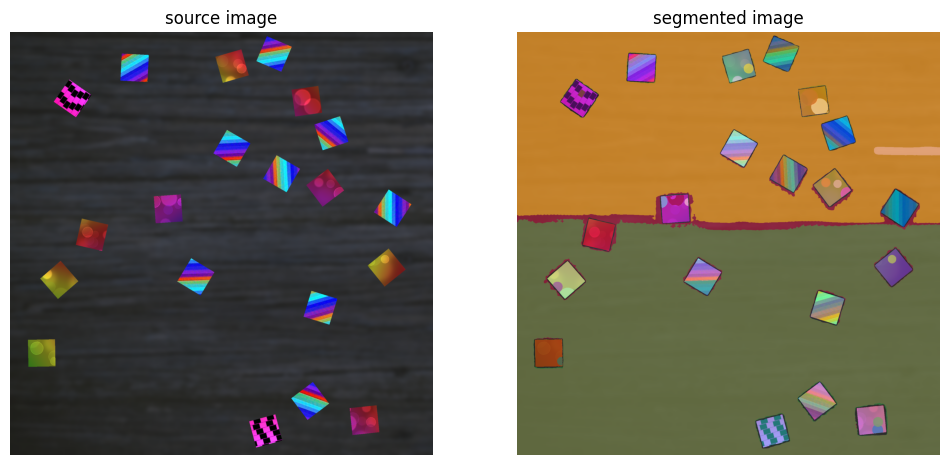


--------------- 2. Masks ---------------



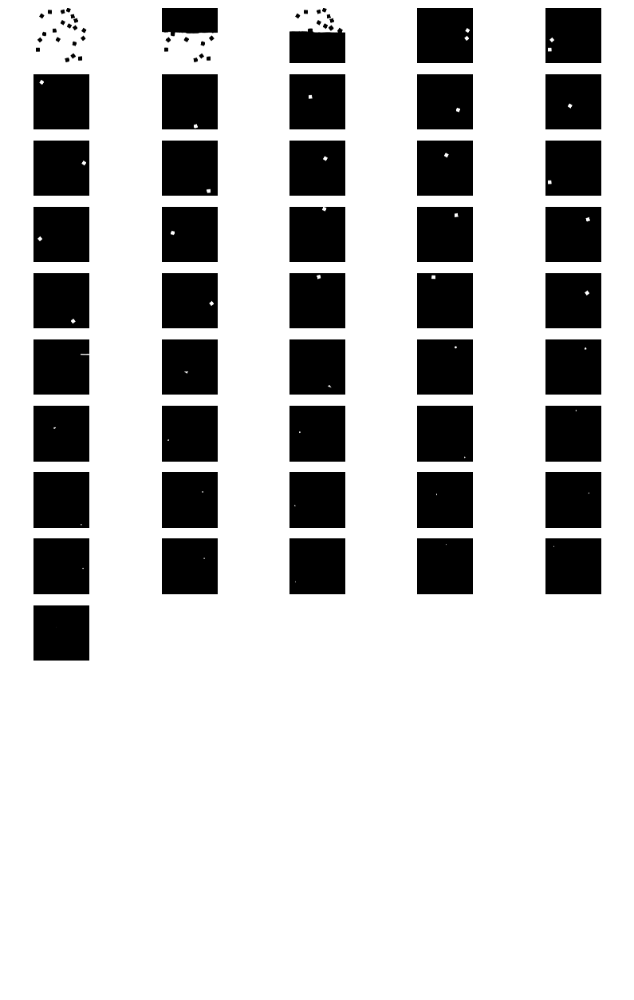


------------- 3. Best mask -------------

best_mask saved! 
 

###########################################################################
############################# Image 05 ####################################
###########################################################################

------------ 1. Sam_result ------------



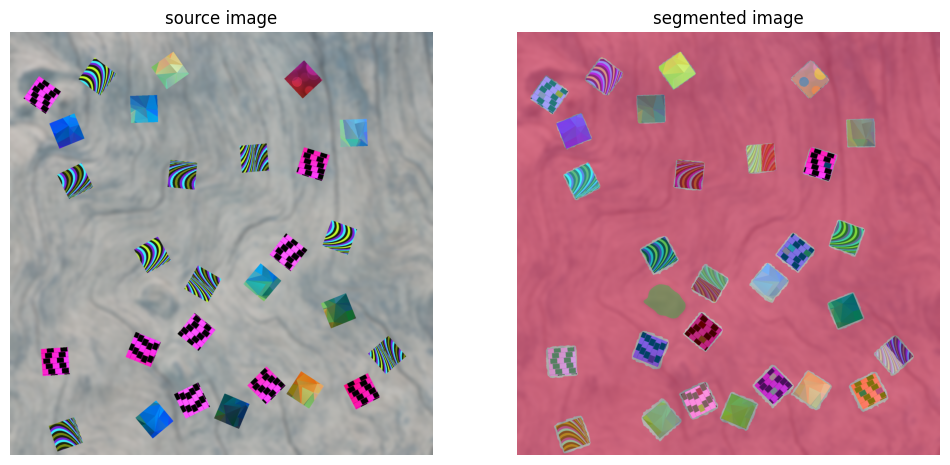


--------------- 2. Masks ---------------



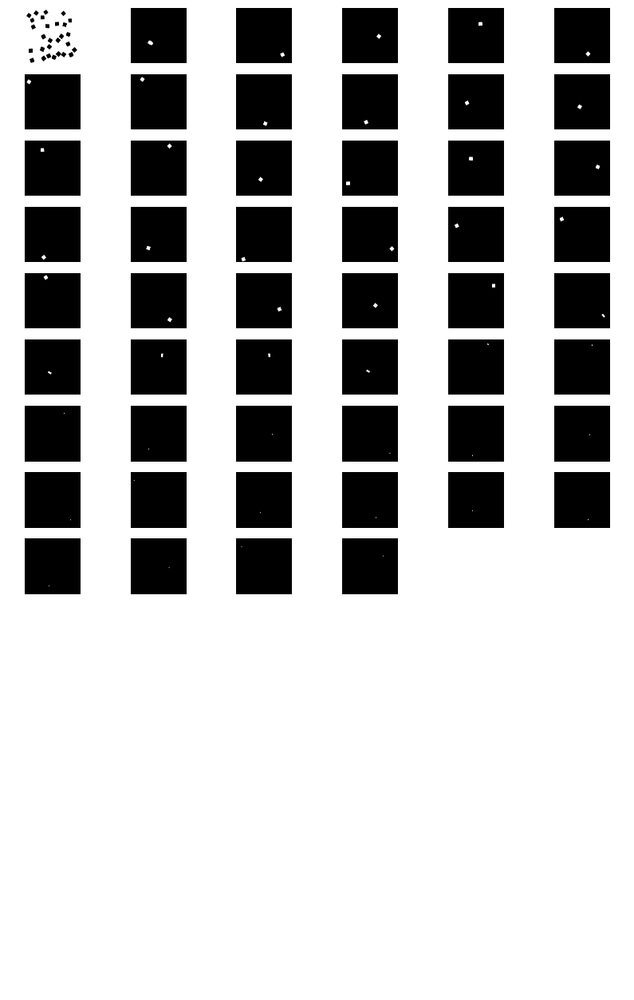


------------- 3. Best mask -------------

best_mask saved! 
 

###########################################################################
############################# Image 06 ####################################
###########################################################################

------------ 1. Sam_result ------------



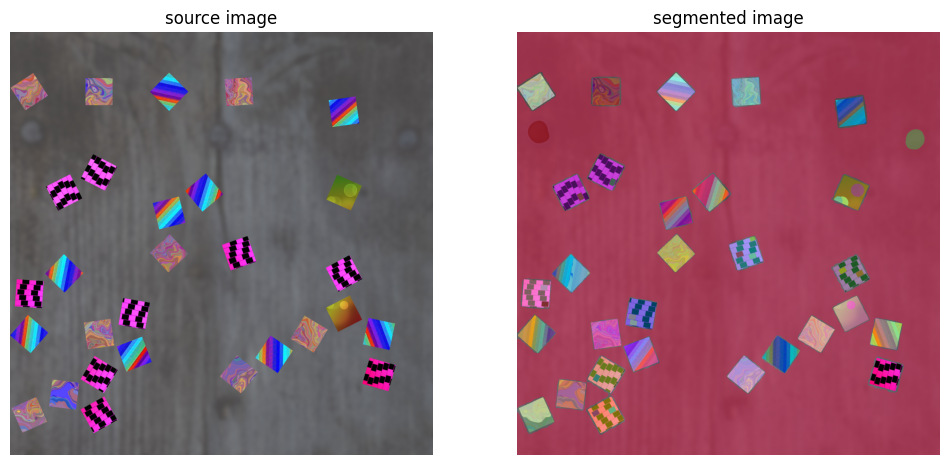


--------------- 2. Masks ---------------



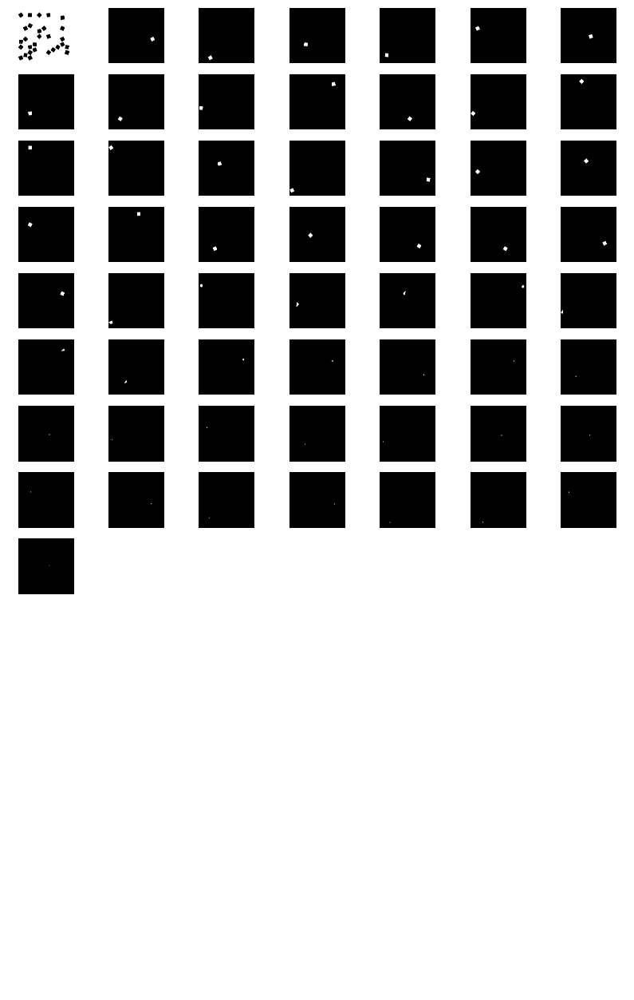


------------- 3. Best mask -------------

best_mask saved! 
 

###########################################################################
############################# Image 07 ####################################
###########################################################################

------------ 1. Sam_result ------------



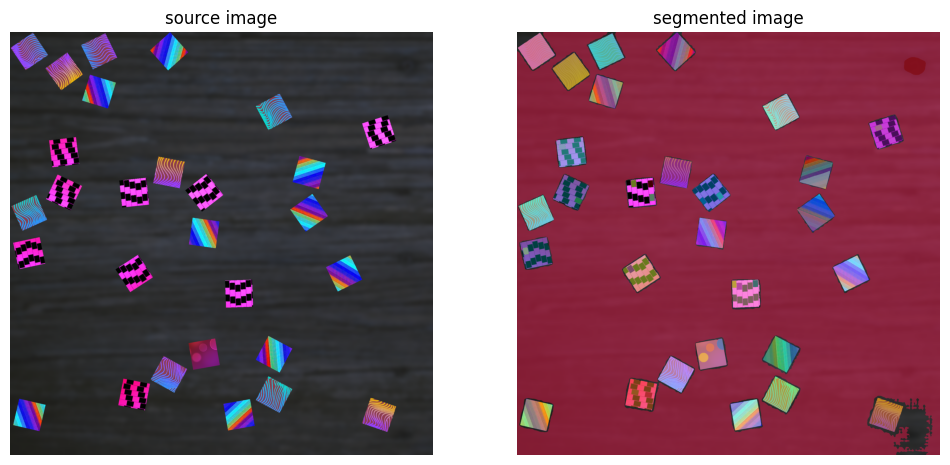


--------------- 2. Masks ---------------



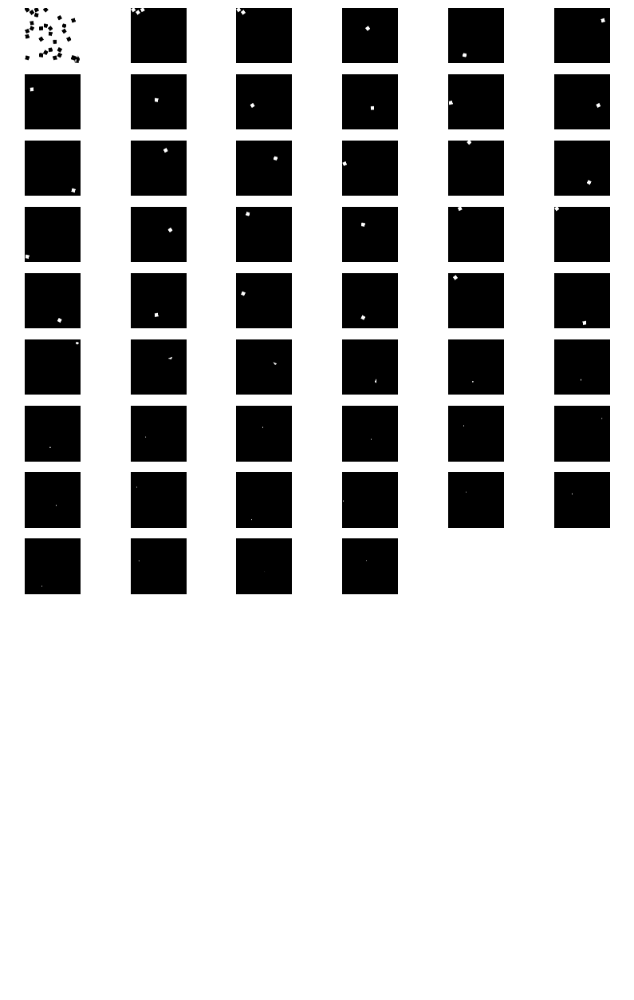


------------- 3. Best mask -------------

best_mask saved! 
 

###########################################################################
############################# Image 08 ####################################
###########################################################################

------------ 1. Sam_result ------------



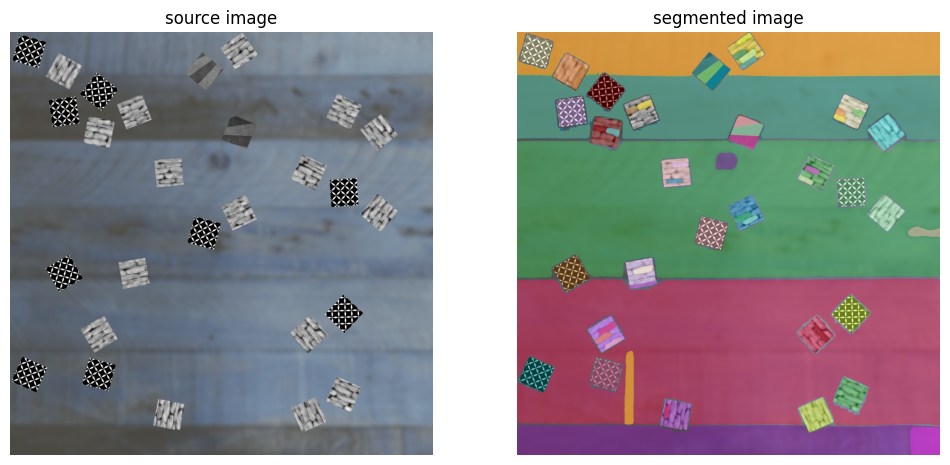


--------------- 2. Masks ---------------



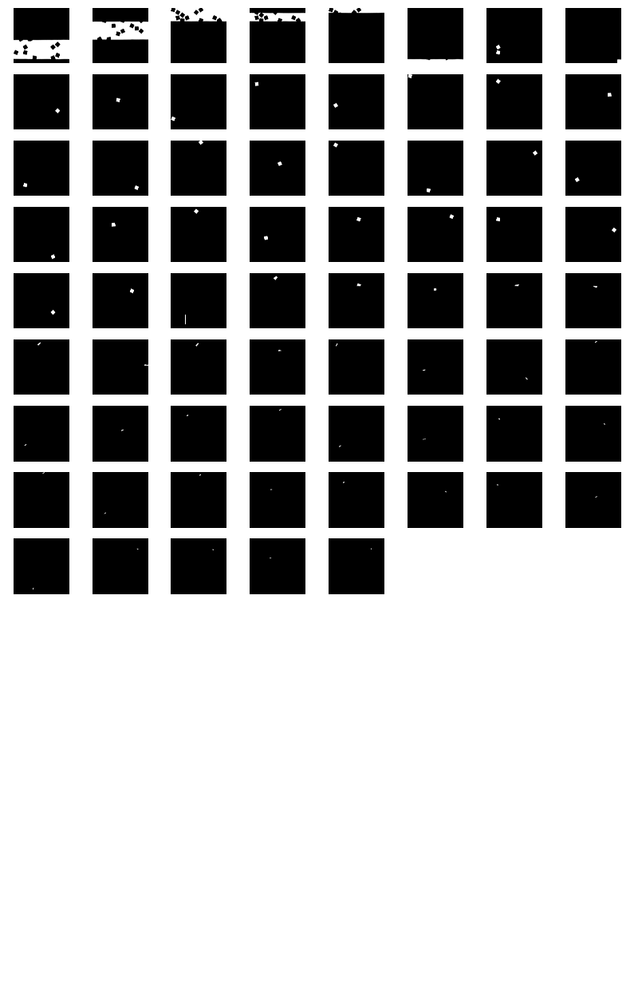


------------- 3. Best mask -------------

best_mask saved! 
 

###########################################################################
############################# Image 09 ####################################
###########################################################################

------------ 1. Sam_result ------------



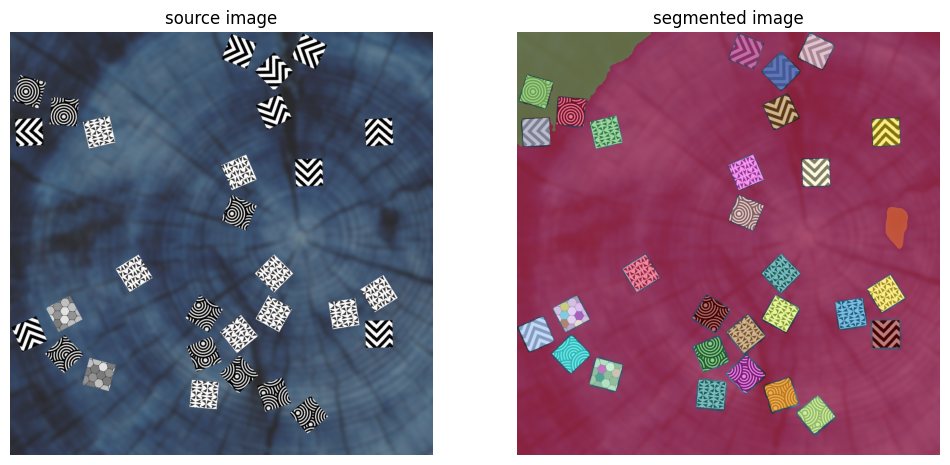


--------------- 2. Masks ---------------



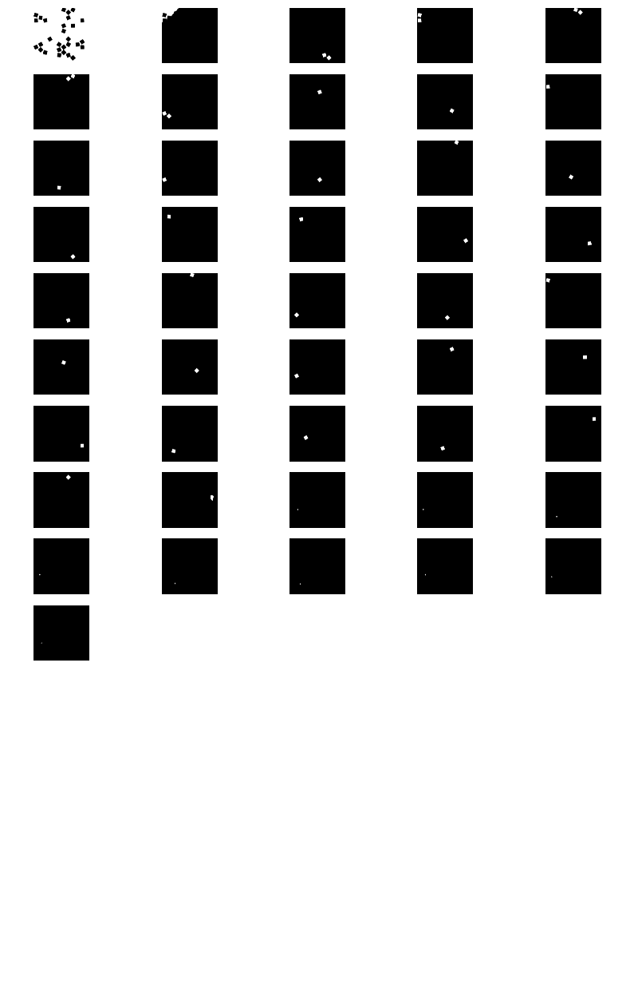


------------- 3. Best mask -------------

best_mask saved! 
 

###########################################################################
############################# Image 10 ####################################
###########################################################################

------------ 1. Sam_result ------------



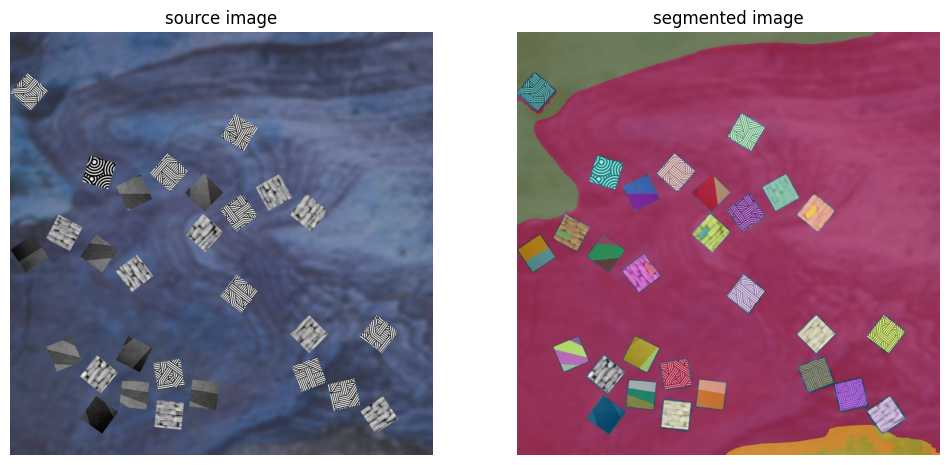


--------------- 2. Masks ---------------



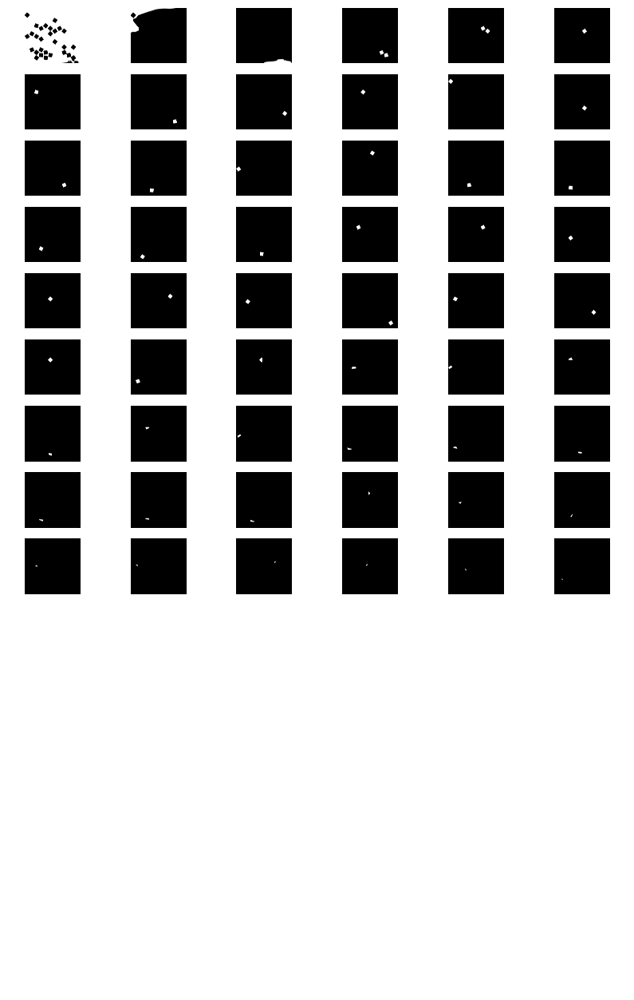


------------- 3. Best mask -------------

best_mask saved! 
 

###########################################################################
############################# Image 11 ####################################
###########################################################################

------------ 1. Sam_result ------------



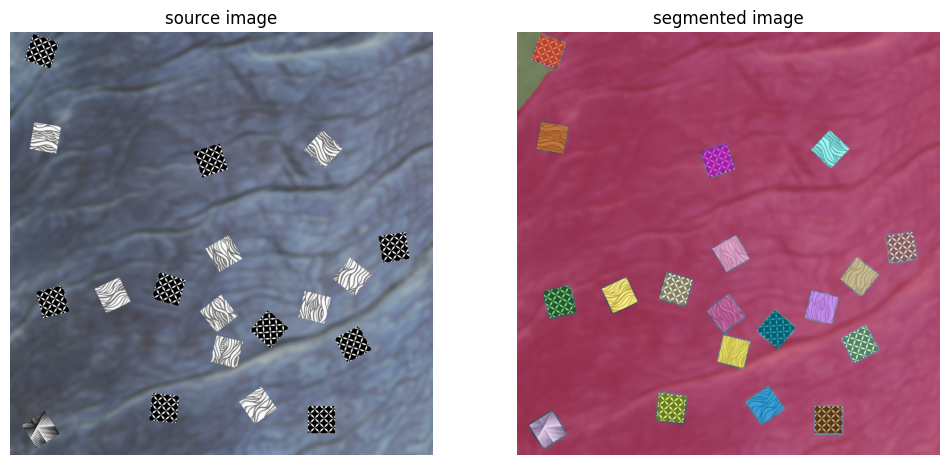


--------------- 2. Masks ---------------



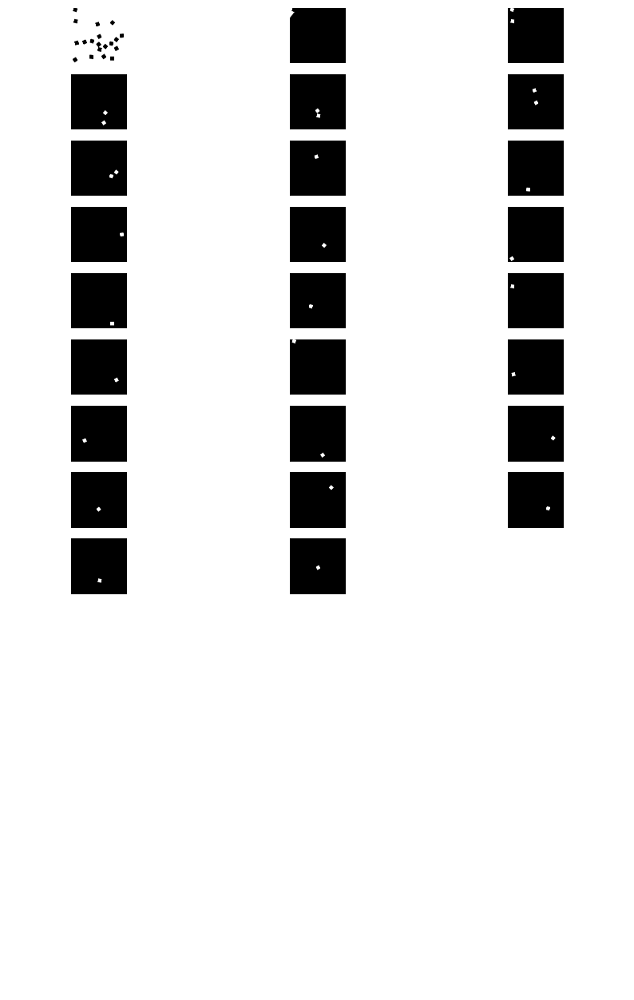


------------- 3. Best mask -------------

best_mask saved! 
 



In [ ]:
# Do the segmentation and get the mask for each train image 

best_masks = []

for i in range(12):

  print('###########################################################################')
  print('############################# Image {} ####################################'.format(str(i).zfill(2)))
  print('###########################################################################')

  # Load image
  image_bgr = load_input_image(i,  folder ="train" , path = ROOT_PATH+"/data_project")


  print('\n------------ 1. Sam_result ------------\n')

  # Generate masks generator with SAM
  image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
  sam_result = mask_generator.generate(image_rgb)

  # See sam_result
  see_segmentation(image_bgr, sam_result)


  print('\n--------------- 2. Masks ---------------\n')

  # Get masks
  masks = [mask['segmentation'] for mask in sorted(sam_result, key=lambda x: x['area'], reverse=True)]

  # See masks
  sv.plot_images_grid(images=masks,
                      grid_size=(15, int(len(masks) / 8)),
                      size=(10, 16)
                      )
  

  print('\n------------- 3. Best mask -------------\n')

  # Keep mask with all pieces of the puzzle and visualize
  best_mask = masks[0]
  best_masks.append(best_mask)
  print("best_mask saved! \n \n")

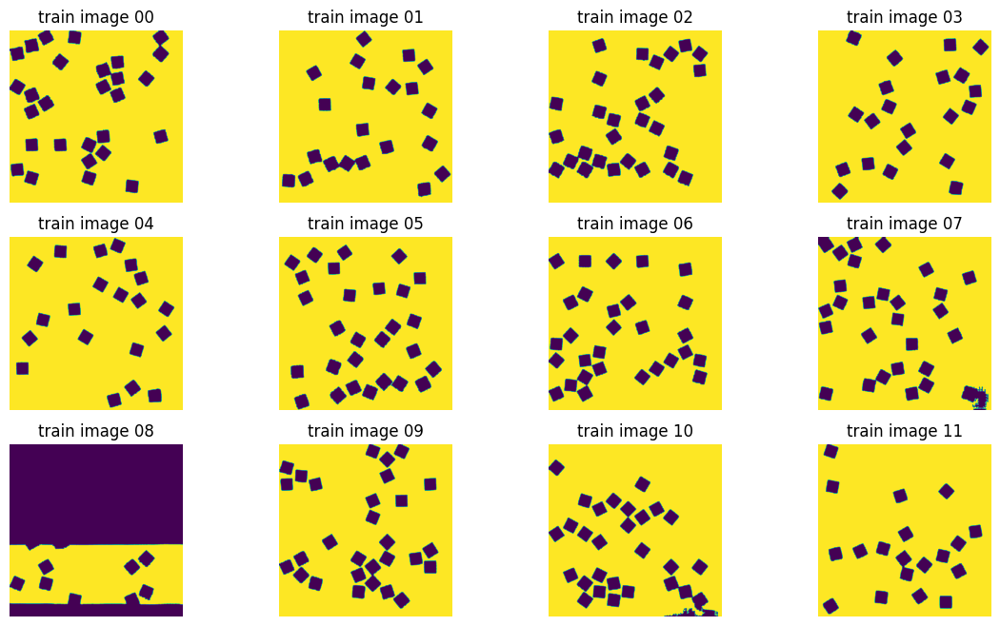

In [ ]:
# Check the best_mask for each image
fig, axs = plt.subplots(3, 4, sharey=True, figsize=(14,8))
axs = axs.flatten()
i = 0
for ax, mask in zip(axs, best_masks):
  ax.imshow(mask)
  ax.axis('off')
  ax.set_title('train image {}'.format(str(i).zfill(2)))
  i += 1

###########################################################################
############################# Image 00 ####################################
###########################################################################

------------- 4. Contours -------------

contours saved! 
 

###########################################################################
############################# Image 01 ####################################
###########################################################################

------------- 4. Contours -------------

contours saved! 
 

###########################################################################
############################# Image 02 ####################################
###########################################################################

------------- 4. Contours -------------

contours saved! 
 

###########################################################################
############################# Image 03 ###############

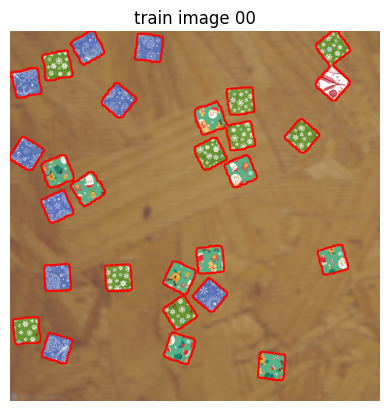

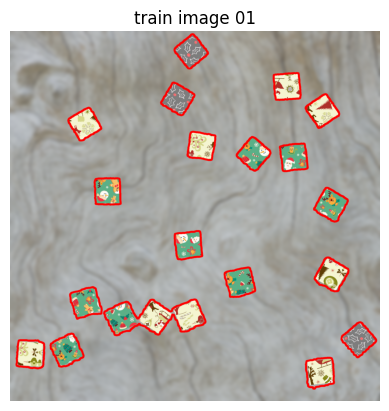

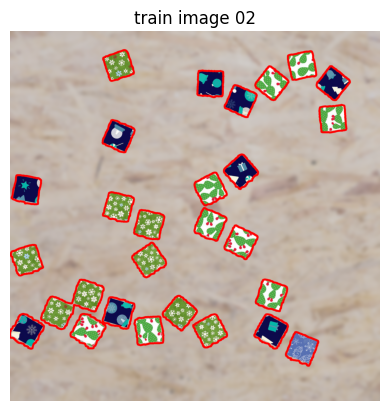

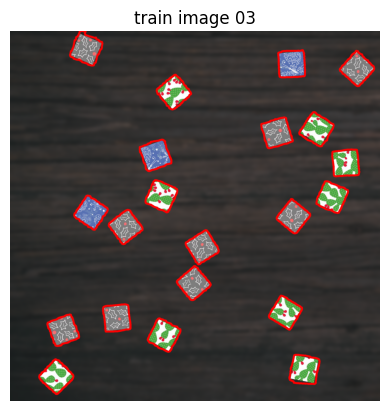

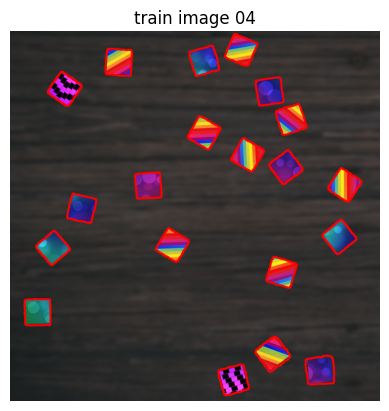

...

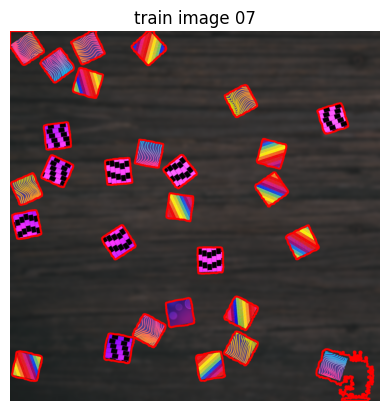

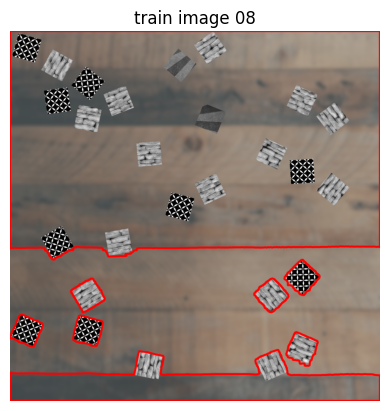

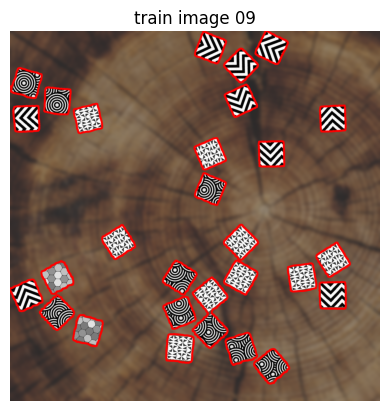

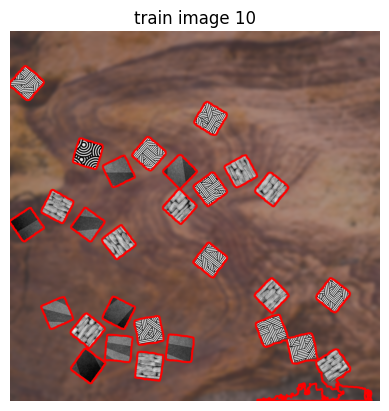

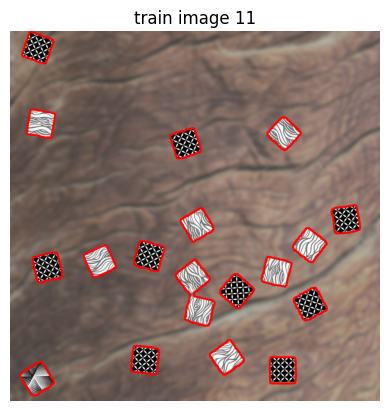

In [ ]:
# Extract contours for each train image

all_contours = []

for i in range(12):

  print('###########################################################################')
  print('############################# Image {} ####################################'.format(str(i).zfill(2)))
  print('###########################################################################')

  # Load image
  image_bgr = load_input_image(i,  folder ="train" , path = ROOT_PATH+"/data_project")


  print('\n------------- 4. Contours -------------\n')

  # Use the best_mask to threshold the image and find the contours
  thresholded_image = cv2.convertScaleAbs(np.where(best_masks[i]==True, 0, 255))
  contours, _ = cv2.findContours(thresholded_image, mode=cv2.RETR_EXTERNAL, method=cv2.CHAIN_APPROX_SIMPLE)
  all_contours.append(contours)
  print('contours saved! \n \n')
  
  # Checking the contours
  plt.figure()
  plt.imshow(cv2.drawContours(image_bgr.copy(), all_contours[i], -1, (255, 0, 0), 10))
  plt.axis('off')
  plt.title('train image {}'.format(str(i).zfill(2)))

In [ ]:
# Transform contours to rectangle for each piece of puzzle for each train image

def rectangle(contours):

  rectangles = []

  for c in range(len(contours)):
    try:
      # Get the minimum area rectangle
      rect = cv2.minAreaRect(contours[c])

      # Adjust the size of the rectangle to match the target size (128x128 pixels)
      desired_size = (128, 128)
      adjusted_rect = (rect[0], desired_size, rect[2])
      rectangles.append(adjusted_rect)

      # Get the rectangle points
      #box = cv2.boxPoints(rect)
      #box = np.int0(box)

      # Prepare the source and destination points for the affine transformation
      #src_pts = box.astype(np.float32)
      #dst_pts = cv2.boxPoints(adjusted_rect).astype(np.float32)

      # Find the affine transformation matrix
      #M = cv2.getAffineTransform(src_pts[:3], dst_pts[:3])

      # Apply the transformation matrix to the rectangle points
      #adjusted_box = cv2.transform(np.array([box]), M)[0]

      # Round the coordinates to integers
      #adjusted_box = np.int0(adjusted_box)

    # Draw the adjusted rectangles on the image
    #plt.figure(figsize = (50,50))
    #plt.imshow(cv2.drawContours(image_bgr.copy(), [adjusted_box], 0, (0, 255, 0), 2))

    except:
      print('issue with contour {}'.format(c))
      continue

  return rectangles



all_rectangles = []
for i in range(12):

  print('###########################################################################')
  print('############################# Image {} ####################################'.format(str(i).zfill(2)))
  print('###########################################################################')

  print('\n------------- 5. Rectangles -------------\n')
  
  # Get the list of rectangles from contours and visualize results
  rectangles = rectangle(all_contours[i])
  all_rectangles.append(rectangles)
  print("rectangles saved!")

###########################################################################
############################# Image 00 ####################################
###########################################################################

------------- 5. Rectangles -------------

rectangles saved!
###########################################################################
############################# Image 01 ####################################
###########################################################################

------------- 5. Rectangles -------------

rectangles saved!
###########################################################################
############################# Image 02 ####################################
###########################################################################

------------- 5. Rectangles -------------

rectangles saved!
###########################################################################
############################# Image 03 ###############

###########################################################################
############################# Image 00 ####################################
###########################################################################

-------------- 6. Cropping  -------------

14
36
38
12
58
62
9
6
49
12
32
47
57
44
45
52
56
63
56
11
62
27
23
20
0
54
all pieces added!


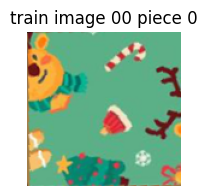

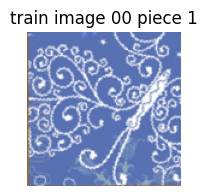

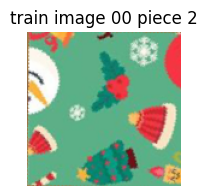

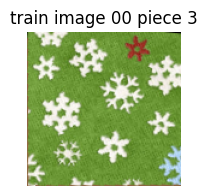

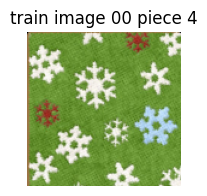

...

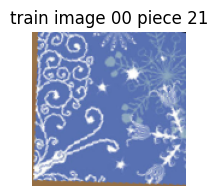

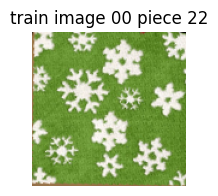

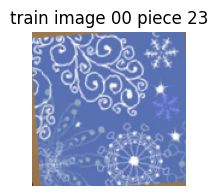

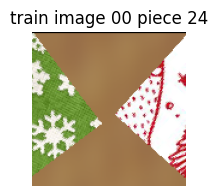

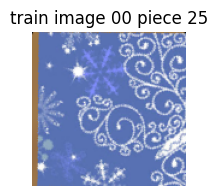


--------------- 7. Saving  -------------

all pieces saved!
###########################################################################
############################# Image 01 ####################################
###########################################################################

-------------- 6. Cropping  -------------

10
7
49
63
1
35
29
53
14
54
4
13
63
16
57
58
56
8
62
all pieces added!


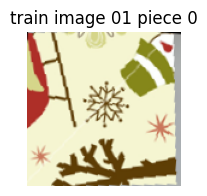

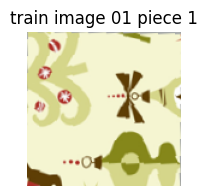

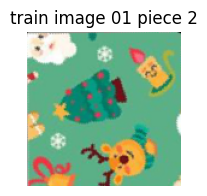

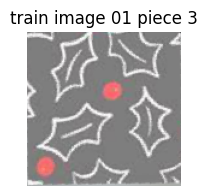

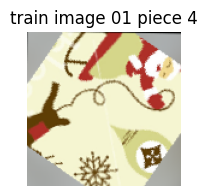

...

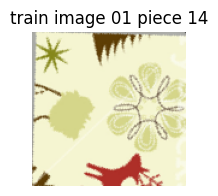

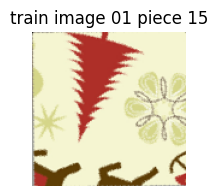

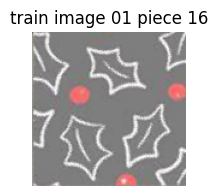

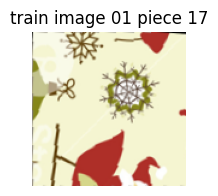

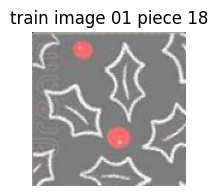


--------------- 7. Saving  -------------

all pieces saved!
###########################################################################
############################# Image 02 ####################################
###########################################################################

-------------- 6. Cropping  -------------

42
13
54
54
58
56
32
63
55
40
37
59
50
30
46
30
24
51
63
45
11
47
4
62
61
22
38
all pieces added!


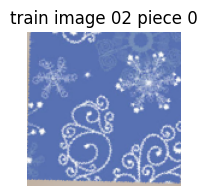

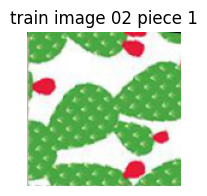

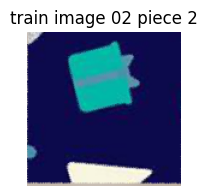

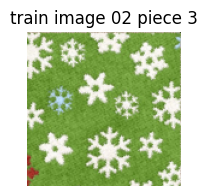

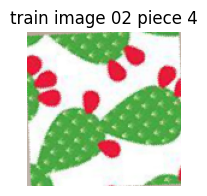

...

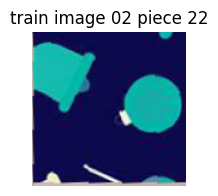

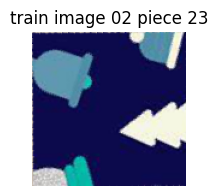

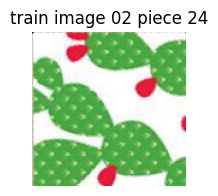

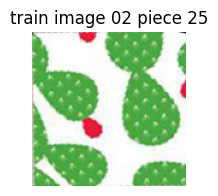

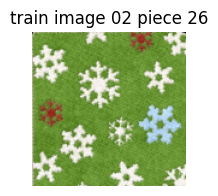


--------------- 7. Saving  -------------

all pieces saved!
###########################################################################
############################# Image 03 ####################################
###########################################################################

-------------- 6. Cropping  -------------

63
22
51
44
14
57
62
57
61
62
59
43
47
11
39
35
58
62
63
5
47
all pieces added!


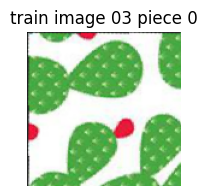

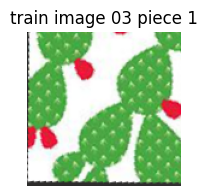

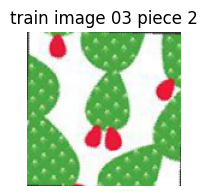

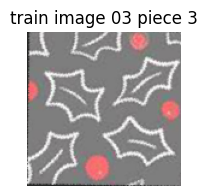

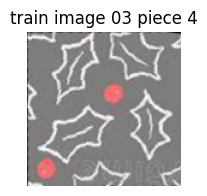

...

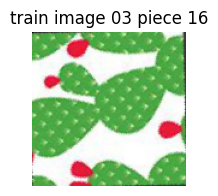

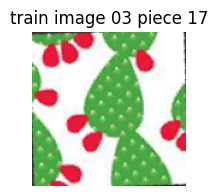

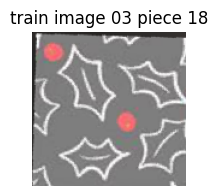

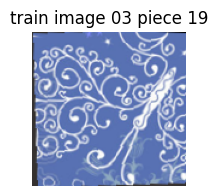

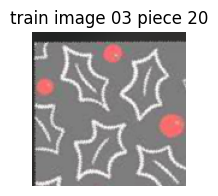


--------------- 7. Saving  -------------

all pieces saved!
###########################################################################
############################# Image 04 ####################################
###########################################################################

-------------- 6. Cropping  -------------

33
11
61
1
34
63
56
62
29
7
58
61
55
56
38
18
59
8
34
47
all pieces added!


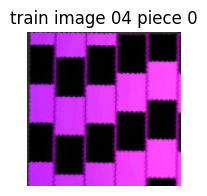

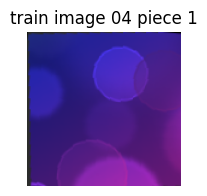

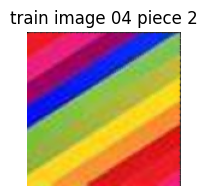

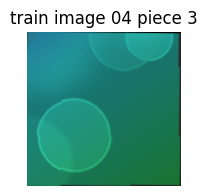

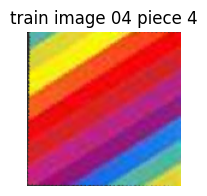

...

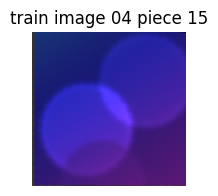

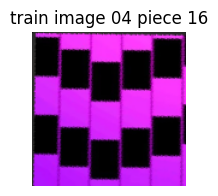

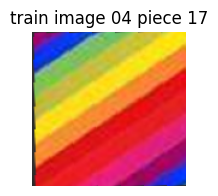

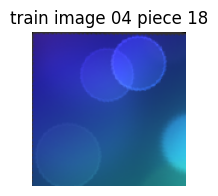

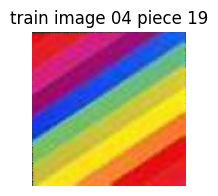


--------------- 7. Saving  -------------

all pieces saved!
###########################################################################
############################# Image 05 ####################################
###########################################################################

-------------- 6. Cropping  -------------

39
63
43
50
51
59
63
6
62
42
63
44
53
63
53
62
41
51
12
36
10
2
45
3
60
63
61
60
all pieces added!


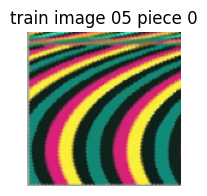

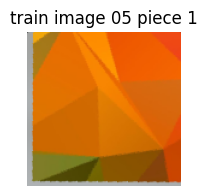

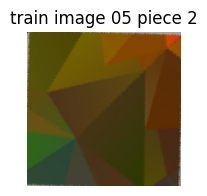

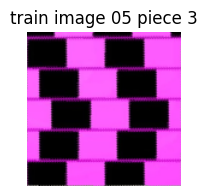

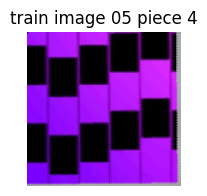

...

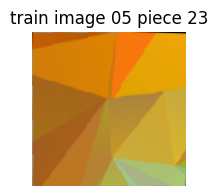

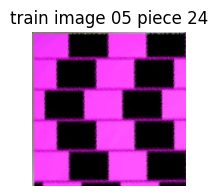

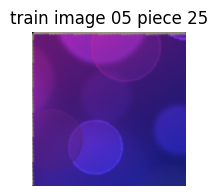

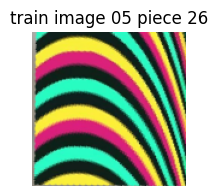

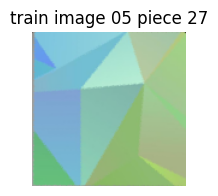


--------------- 7. Saving  -------------

all pieces saved!
###########################################################################
############################# Image 06 ####################################
###########################################################################

-------------- 6. Cropping  -------------

48
13
35
62
1
42
59
16
23
56
Proposed rectangle is not fully in the image.
21
51
9
53
63
38
63
29
49
51
62
52
18
11
0
58
63
all pieces added!


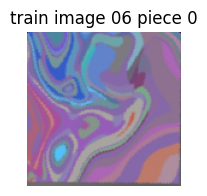

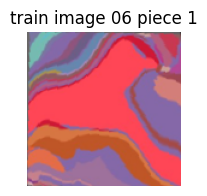

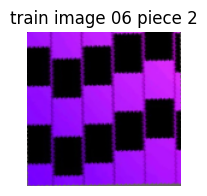

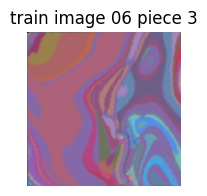

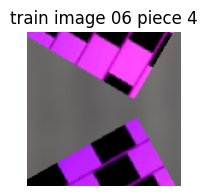

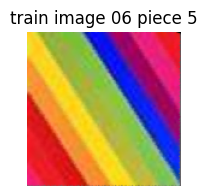

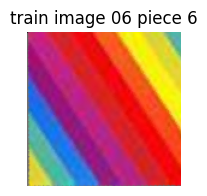

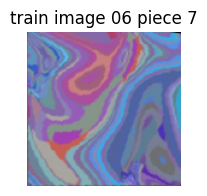

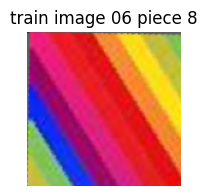

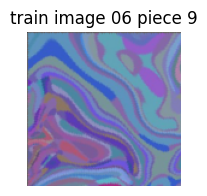

issue with train image 06 piece 10


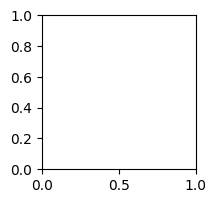

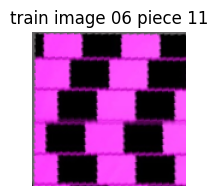

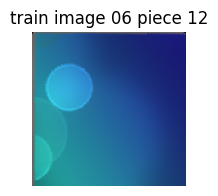

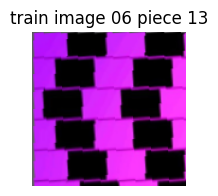

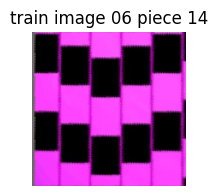

...

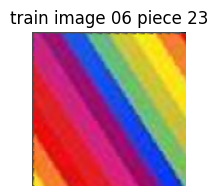

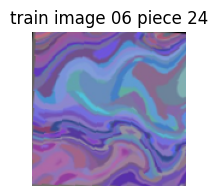

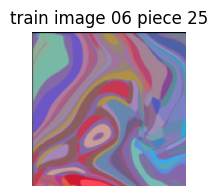

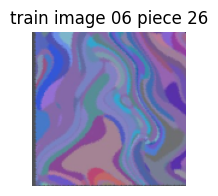

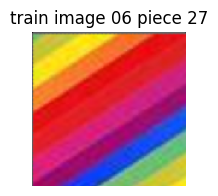


--------------- 7. Saving  -------------

issue with train image 06 piece 10
all pieces saved!
###########################################################################
############################# Image 07 ####################################
###########################################################################

-------------- 6. Cropping  -------------

18
28
9
52
54
22
52
2
51
58
25
17
46
59
15
49
61
24
32
15
35
53
35
61
Proposed rectangle is not fully in the image.
50
Proposed rectangle is not fully in the image.
all pieces added!


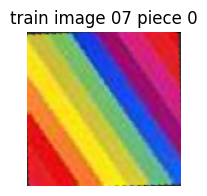

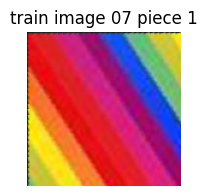

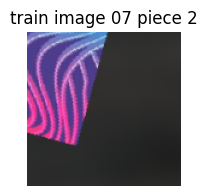

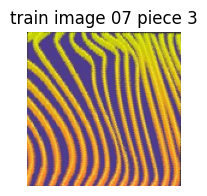

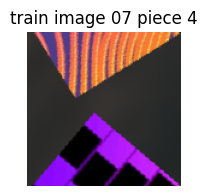

...

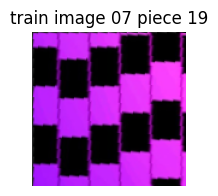

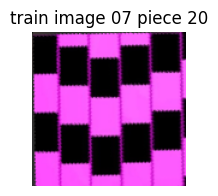

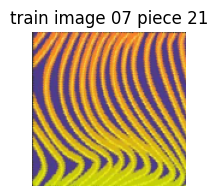

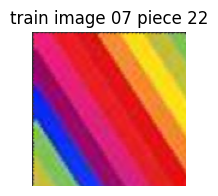

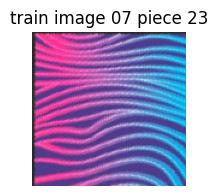

issue with train image 07 piece 24


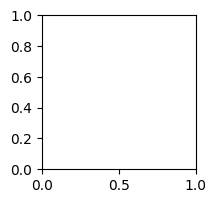

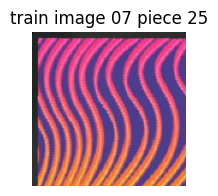

issue with train image 07 piece 26

--------------- 7. Saving  -------------

issue with train image 07 piece 24
issue with train image 07 piece 26
all pieces saved!
###########################################################################
############################# Image 08 ####################################
###########################################################################

-------------- 6. Cropping  -------------

0
49
31
46
63
55
63
0
all pieces added!


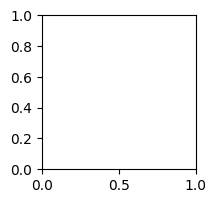

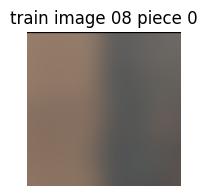

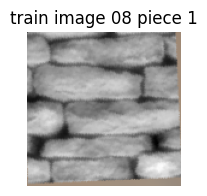

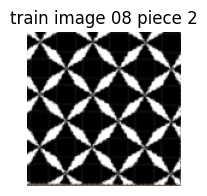

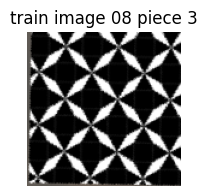

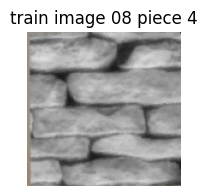

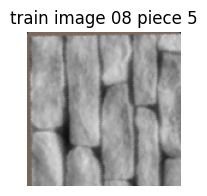

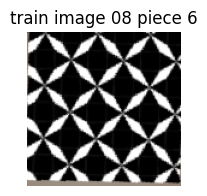

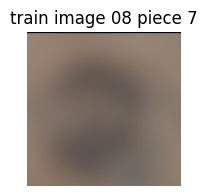


--------------- 7. Saving  -------------

all pieces saved!
###########################################################################
############################# Image 09 ####################################
###########################################################################

-------------- 6. Cropping  -------------

62
12
37
31
45
63
2
47
0
19
52
54
57
57
58
63
45
2
46
5
5
27
12
49
33
63
43
50
all pieces added!


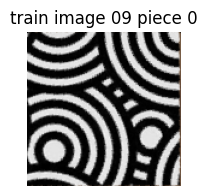

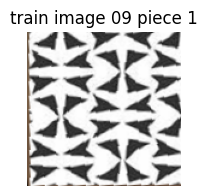

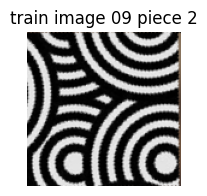

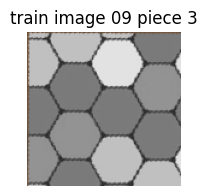

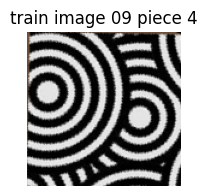

...

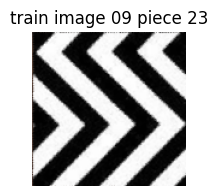

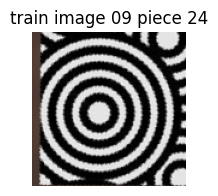

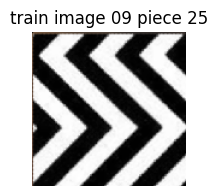

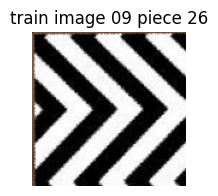

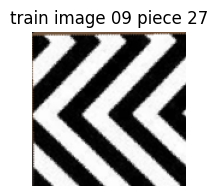


--------------- 7. Saving  -------------

all pieces saved!
###########################################################################
############################# Image 10 ####################################
###########################################################################

-------------- 6. Cropping  -------------

14
60
11
13
25
0
62
46
51
62
63
62
61
59
60
52
62
61
50
54
0
35
63
55
Proposed rectangle is not fully in the image.
all pieces added!


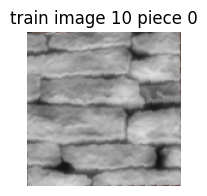

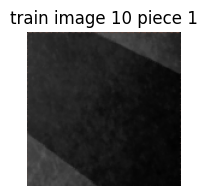

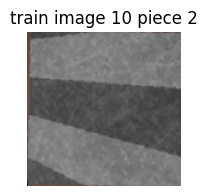

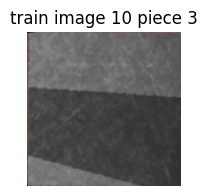

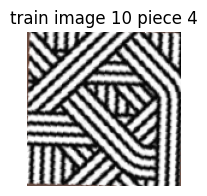

...

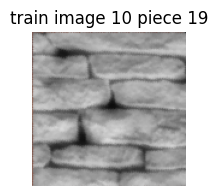

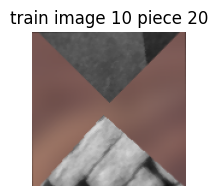

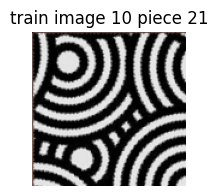

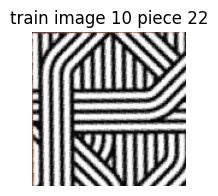

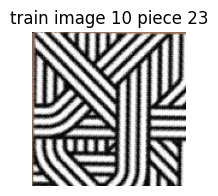

issue with train image 10 piece 24

--------------- 7. Saving  -------------

issue with train image 10 piece 24
all pieces saved!
###########################################################################
############################# Image 11 ####################################
###########################################################################

-------------- 6. Cropping  -------------

57
0
14
60
54
63
25
30
26
47
34
61
55
19
37
63
23
38
all pieces added!


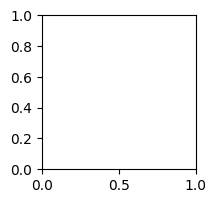

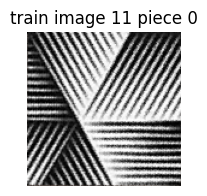

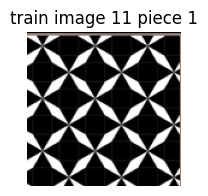

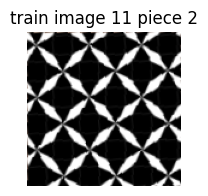

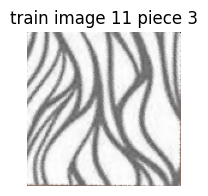

...

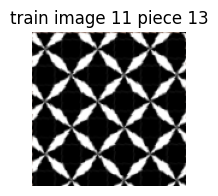

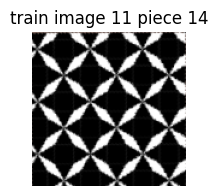

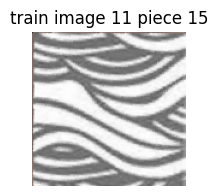

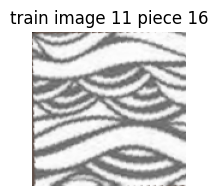

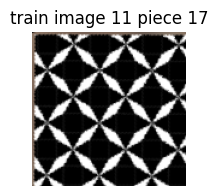


--------------- 7. Saving  -------------

all pieces saved!


In [ ]:
# Extract+save each piece of puzzle for each train image

for i in range(12):

  print('###########################################################################')
  print('############################# Image {} ####################################'.format(str(i).zfill(2)))
  print('###########################################################################')

  # Load image
  image_bgr = load_input_image(i,  folder ="train" , path = ROOT_PATH+"/data_project")


  print('\n-------------- 6. Cropping  -------------\n')
  
  # Get each pieces from the original image
  all_pieces = []
  for r in range(len(all_rectangles[i])):
    piece = crop_rotated_rectangle(image_bgr.copy(), all_rectangles[i][r])
    all_pieces.append(piece)
  print("all pieces added!")
  
  # See results
  for num_p, p in enumerate(all_pieces):
    try:
      plt.figure(figsize=(2,2))
      plt.imshow(p)
      plt.axis('off')
      plt.title('train image {} piece {}'.format(str(i).zfill(2), num_p))
      plt.show()
    except:
      print('issue with train image {} piece {}'.format(str(i).zfill(2), num_p))
      continue
  

  print('\n--------------- 7. Saving  -------------\n')
  
  # Save results
  for num_p, p in enumerate(all_pieces):
    try:
      name = '/data_project/pieces/train{}_piece{}.png'.format(str(i).zfill(2), num_p)
      Image.fromarray(p).save(ROOT_PATH+name)
    except:
      print('issue with train image {} piece {}'.format(str(i).zfill(2), num_p))
      continue
  print("all pieces saved!")

### 4.3. Features extraction

In [5]:
# Install
!pip install colorthief

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [89]:
# Import
from PIL import Image
import matplotlib.pyplot as plt
from colorthief import ColorThief
from skimage import io
import cv2
from skimage.filters import gabor_kernel, gabor
from scipy import ndimage as ndi
from skimage.util import img_as_float
from sklearn.decomposition import PCA
import re
from sklearn.preprocessing import StandardScaler

#### Feature 1: Hue of dominant color

Dominant color in RGB: [ 97 171 129]
Hue of dominant color: 73


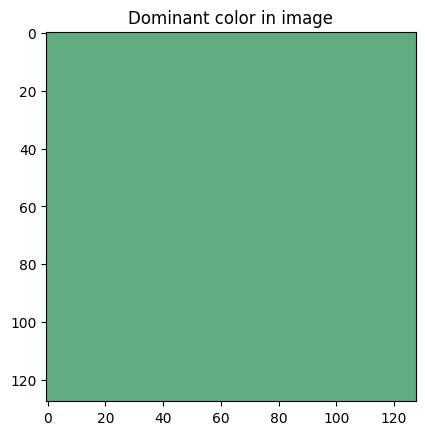

In [13]:
# Have a look to feature 1

color_thief = ColorThief(ROOT_PATH+'/data_project/pieces/train00_piece0.png')  # Take a piece for example
dominant_color = np.uint8(list(color_thief.get_color(2))).reshape((1,1,3))
print(f'Dominant color in RGB: {np.squeeze(dominant_color)}')
dominantHue = cv2.cvtColor(dominant_color, cv2.COLOR_RGB2HSV)
print(f'Hue of dominant color: {np.squeeze(dominantHue)[0]}')

dominant_color_img = np.tile(dominant_color, (128,128,1))
plt.imshow(dominant_color_img)
plt.title('Dominant color in image')
plt.show()

#### Feature 2: Gabor filter

<ipython-input-14-dc0c7b659778>:13: ComplexWarning: Casting complex values to real discards the imaginary part
  feats[k, 0] = filtered.mean()


Features of im1 are : Mean of 116.76 and std of 390.30 
Features of im2 are : Mean of 115.90 and std of 382.37 
Features of im3 are : Mean of 121.01 and std of 760.12 


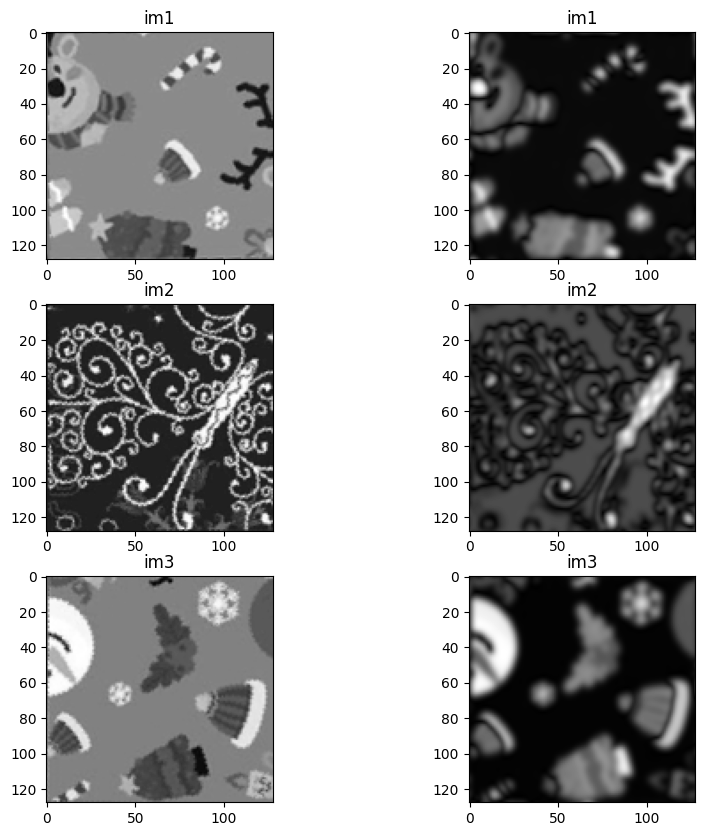

In [14]:
# Have a look to feature 2

def power(image, kernel):
    # Normalize images for better comparison.
    image = (image - image.mean()) / image.std()
    return np.sqrt(ndi.convolve(image, np.real(kernel), mode='wrap')**2 +
                   ndi.convolve(image, np.imag(kernel), mode='wrap')**2)

def compute_feats_images(image, kernels):
    feats = np.zeros((len(kernels), 2), dtype=np.double)
    for k, kernel in enumerate(kernels):
        filtered = ndi.convolve(image, kernel, mode='wrap')
        feats[k, 0] = filtered.mean()
        feats[k, 1] = filtered.var()
    return feats

# Prepare filter bank kernels
kernels = []
for theta in range(4):
    theta = theta / 4. * np.pi
    for sigma in (1,3):
        for frequency in (0.05, 0.25):
            kernel = gabor_kernel(frequency, theta=theta, sigma_x=2, sigma_y=2)
            kernels.append(kernel)

# Take three pieces for example
im1 = cv2.cvtColor(cv2.imread(ROOT_PATH+'/data_project/pieces/train00_piece0.png'), cv2.COLOR_BGR2GRAY)
im2 = cv2.cvtColor(cv2.imread(ROOT_PATH+'/data_project/pieces/train00_piece1.png'), cv2.COLOR_BGR2GRAY)
im3 = cv2.cvtColor(cv2.imread(ROOT_PATH+'/data_project/pieces/train00_piece2.png'), cv2.COLOR_BGR2GRAY)

image_names = ('im1', 'im2', 'im3')
images = (im1, im2, im3)

ref_feats = np.zeros((3, len(kernels), 2), dtype=np.double)
ref_feats[0, :, :] = compute_feats_images(im1, kernels)
ref_feats[1, :, :] = compute_feats_images(im2, kernels)
ref_feats[2, :, :] = compute_feats_images(im3, kernels)

kernel_nb=0
filt_images_1 = power(im1, kernels[kernel_nb])
filt_images_2 = power(im2, kernels[kernel_nb])
filt_images_3 = power(im3, kernels[kernel_nb])

filt_images = [filt_images_1, filt_images_2, filt_images_3]

for i,nm in enumerate(image_names):
    print(f"Features of {nm} are : Mean of {ref_feats[i,kernel_nb,0]:.2f} and std of {ref_feats[i,kernel_nb,1]:.2f} ")

# Plotting
fig, axes = plt.subplots(3,2, figsize=(10,10))
for i,row in enumerate(axes):
    row[0].imshow(images[i],cmap='gray')
    row[1].imshow(filt_images[i],cmap='gray')
    row[0].title.set_text(image_names[i])
    row[1].title.set_text(image_names[i])

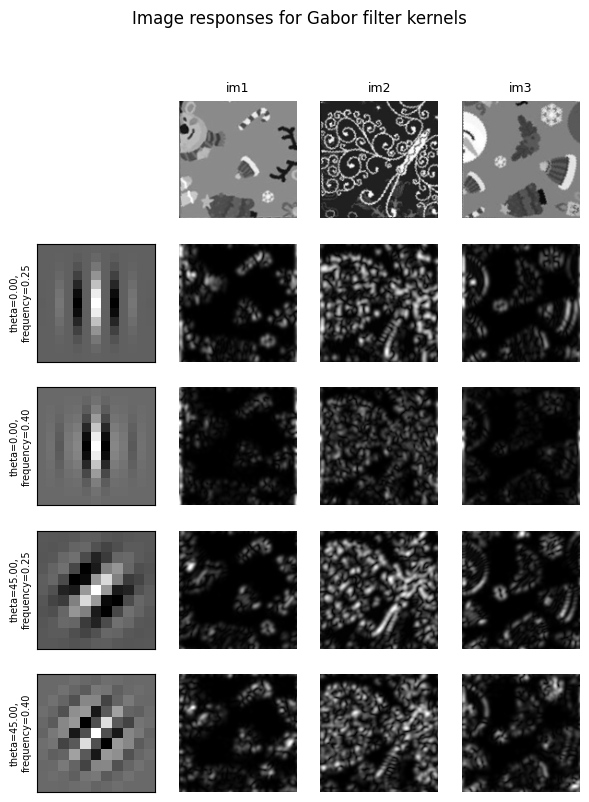

In [15]:
# Plot a selection of the filter bank kernels and their responses.
results = []
kernel_params = []
for theta in (0, 1):
    theta = theta / 4. * np.pi
    for frequency in (0.25, 0.4):
        kernel = gabor_kernel(frequency, theta=theta, sigma_x=2, sigma_y=2)
        params = f"theta={theta * 180. / np.pi:.2f},\nfrequency={frequency:.2f}"
        kernel_params.append(params)
        # Save kernel and the power image for each image
        results.append((kernel, [power(img, kernel) for img in images]))

# Plotting:
fig, axes = plt.subplots(5, 4, figsize=(7, 9))
plt.gray()

fig.suptitle('Image responses for Gabor filter kernels', fontsize=12)

axes[0][0].axis('off')

# Plot original images
for label, img, ax in zip(image_names, images, axes[0][1:]):
    ax.imshow(img)
    ax.set_title(label, fontsize=9)
    ax.axis('off')

for label, (kernel, powers), ax_row in zip(kernel_params, results, axes[1:]):
    # Plot Gabor kernel
    ax = ax_row[0]
    ax.imshow(np.real(kernel))
    ax.set_ylabel(label, fontsize=7)
    ax.set_xticks([])
    ax.set_yticks([])

    # Plot Gabor responses with the contrast normalized for each filter
    for patch, ax in zip(powers, ax_row[1:]):
        vmin = np.min(patch)
        vmax = np.max(patch)
        ax.imshow(patch, vmin=vmin, vmax=vmax)
        ax.axis('off')

plt.show()

#### Function to get feature vector and apply it to each piece

In [24]:
def get_features(im, path_piece):
    # im should be rgb for color extraction to work!
    
    feature_vector = []

    color_thief = ColorThief(path_piece)
    dominant_color = np.uint8(list(color_thief.get_color(2))).reshape((1,1,3))
    dominantHue = np.squeeze(cv2.cvtColor(dominant_color, cv2.COLOR_RGB2HSV))[0]
    feature_vector.append(dominantHue)

    im = np.array(im)
    im = cv2.cvtColor(im, cv2.COLOR_RGB2GRAY)

    sigma_x=2
    sigma_y=2

    for theta in range(4):
        theta = theta / 4. * np.pi
        for sigma in (1,3):
            for frequency in (0.05, 0.25):
                filt_real, filt_im = gabor(image=im, frequency=frequency, theta=theta, sigma_x=sigma, sigma_y=sigma)
                feature_vector.append(filt_real.mean())
                feature_vector.append(filt_real.var())
                
    return feature_vector

In [25]:
# Function to load pieces

def load_piece(image_index, piece_index, folder="pieces", path=ROOT_PATH+"/data_project"):
    
    filename = "train{}_piece{}.png".format(image_index, piece_index)
    path_piece = os.path.join(path, folder, filename)
    
    piece = Image.open(path_piece).convert('RGB')
    piece = np.array(piece)
    return piece, path_piece

In [32]:
# Get a list of list of tuples to get the ref of each piece
# Ex: [[('00', '1'), ('00', '2'), ('00', '3')], [('01', '1'), ('01', '2'), ('01', '3')], etc.]

files_pieces = os.listdir(ROOT_PATH+"/data_project/pieces")
list_pieces = sorted([re.findall(r'train(\d+)_piece(\d+)\.png', s)[0] for s in all])

sublists = {}
for p in list_pieces:
    key = p[0]
    if key in sublists:
        sublists[key].append(p)
    else:
        sublists[key] = [p]

list_im_pieces = list(sublists.values())

In [33]:
# Apply get_features to each piece of each image

features_pieces = [[] for i in range(len(list_im_pieces))]

for i, l in enumerate(list_im_pieces):
  for tup in l:
    piece, path_piece = load_piece(tup[0], tup[1])
    features_pieces[i].append(get_features(piece, path_piece))

In [36]:
features_pieces[0][0]

[73,
 134.74322509765625,
 646.3326872549951,
 40.9051513671875,
 77.0836551040411,
 90.762451171875,
 207.18600219488144,
 19.25701904296875,
 4484.204021777958,
 134.744873046875,
 646.1341289877892,
 40.93780517578125,
 76.21628561243415,
 91.62109375,
 207.74400329589844,
 21.8807373046875,
 5054.464902386069,
 134.74359130859375,
 646.4722794853151,
 40.89971923828125,
 77.45362785086036,
 90.765625,
 208.7911376953125,
 20.02471923828125,
 4659.25506522879,
 134.7459716796875,
 646.5342244952917,
 40.93316650390625,
 77.93602400645614,
 91.60321044921875,
 211.80074897035956,
 21.724853515625,
 5018.588845193386]

#### PCA of pieces for each image

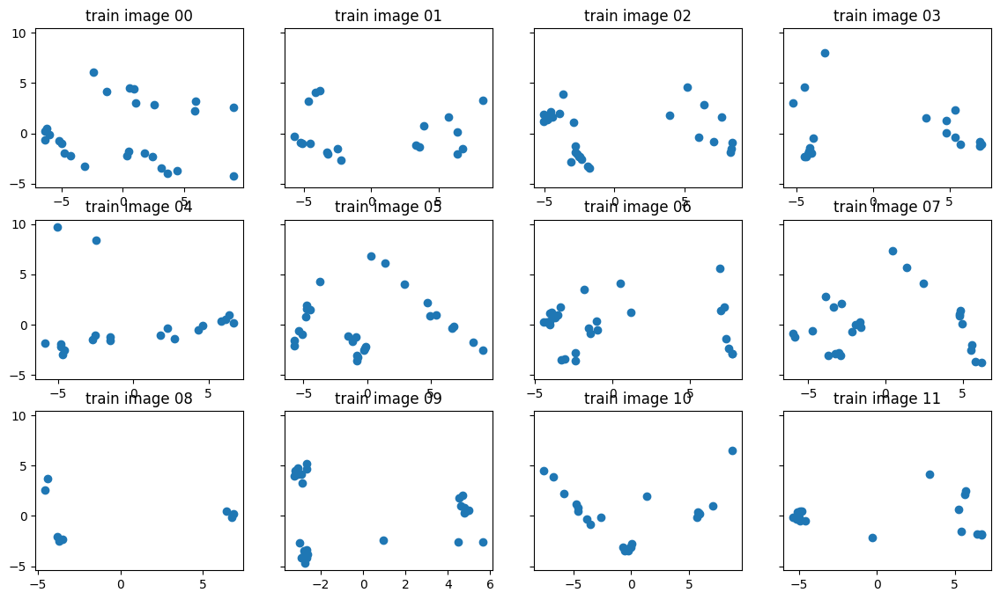

In [90]:
# PCA using features_pieces

fig, axs = plt.subplots(3, 4, sharey=True, figsize=(14,8))
axs = axs.flatten()

for ax, idx_im in zip(axs, [idx_im for idx_im in range(len(features_pieces))]):
  
  scaler = StandardScaler()
  normalized_data = scaler.fit_transform(features_pieces[idx_im])

  pca = PCA(n_components=2)
  pca.fit(normalized_data)
  res = pca.transform(normalized_data)

  ax.scatter(res[:,0], res[:,1])
  ax.set_title('train image {}'.format(str(idx_im).zfill(2)))

plt.show()

### 4.4. Clustering with KMeans

In [105]:
# Import
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

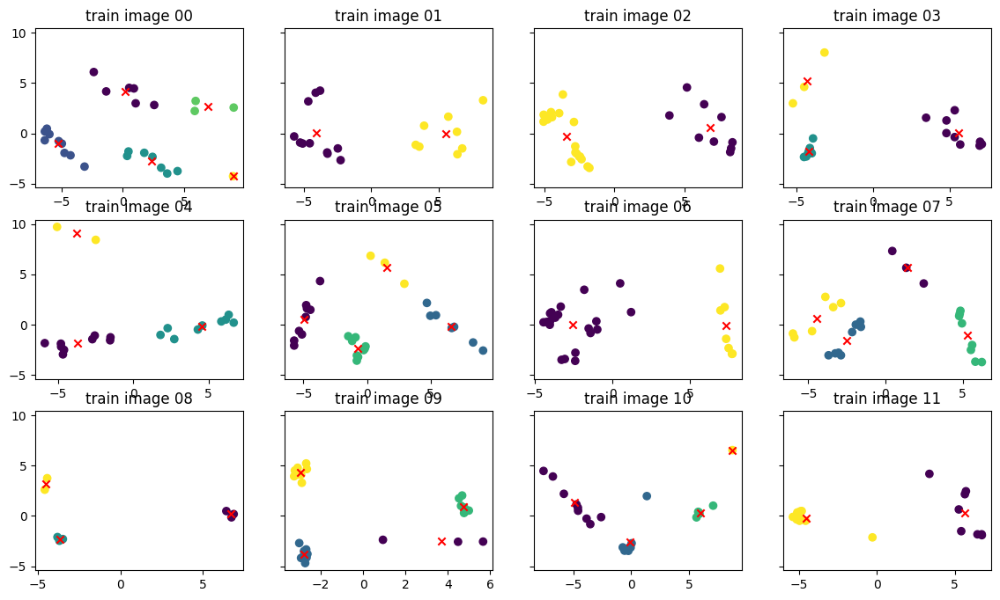

In [106]:
# Either 2 or 3 puzzles -> choose 3 clusters for KMeans

list_im_clusters = []

fig, axs = plt.subplots(3, 4, sharey=True, figsize=(14,8))
axs = axs.flatten()

for ax, idx_im in zip(axs, [idx_im for idx_im in range(len(features_pieces))]):

  scaler = StandardScaler()
  normalized_data = scaler.fit_transform(features_pieces[idx_im])

  # 1. Find the best k

  silhouette_scores = []
  k_range = range(2, 6)  # Range of k values to try

  for k in k_range:
      kmeans = KMeans(n_clusters=k)
      labels = kmeans.fit_predict(normalized_data)
      silhouette_avg = silhouette_score(normalized_data, labels)
      silhouette_scores.append(silhouette_avg)

  best_k = k_range[silhouette_scores.index(max(silhouette_scores))] # Find the k value with the highest silhouette score

  # 2. Cluster with KMeans
  
  kmeans = KMeans(n_clusters=best_k)
  kmeans.fit(normalized_data)
  
  clusters = kmeans.predict(normalized_data)
  list_im_clusters.append(list(clusters))

  clusters_centers = kmeans.cluster_centers_


  # 3. Plot

  pca = PCA(n_components=2)
  pca.fit(normalized_data)
  res = pca.transform(normalized_data)
  ax.scatter(res[:,0], res[:,1], c=clusters)
  ax.set_title('train image {}'.format(str(idx_im).zfill(2)))
  centers2d = pca.transform(kmeans.cluster_centers_)
  ax.scatter(centers2d[:,0], centers2d[:,1], marker='x', c='red')

plt.show()

In [107]:
# Group filenames by cluster

def group_clusters(tup_names, clusters):
  sublists = {}
  for i, tup_name in enumerate(tup_names):
      cluster = clusters[i]
      if cluster in sublists:
          sublists[cluster].append("train{}_piece{}.png".format(tup_name[0], tup_name[1]))
      else:
          sublists[cluster] = ["train{}_piece{}.png".format(tup_name[0], tup_name[1])]
  result = list(sublists.values())
  return result

filename_and_clusters = []

for i, l in enumerate(list_im_pieces):
  filename_and_clusters.append(group_clusters(list_im_pieces[i], list_im_clusters[i]))

In [108]:
# Function to see cluster per image

def see_clusters_per_image(im_idx):
  
  for cluster, l in enumerate(filename_and_clusters[im_idx]):

    fig, axs = plt.subplots(int(len(l)/5)+1, 5, sharey=True, figsize=(14,8))
    axs = axs.flatten()
    
    for ax, f_name in zip(axs, l):
      
      piece = Image.open(os.path.join(ROOT_PATH+"/data_project", "pieces", f_name)).convert('RGB')
      ax.imshow(piece)
      ax.set_title('cluster{}'.format(cluster))

  plt.show()

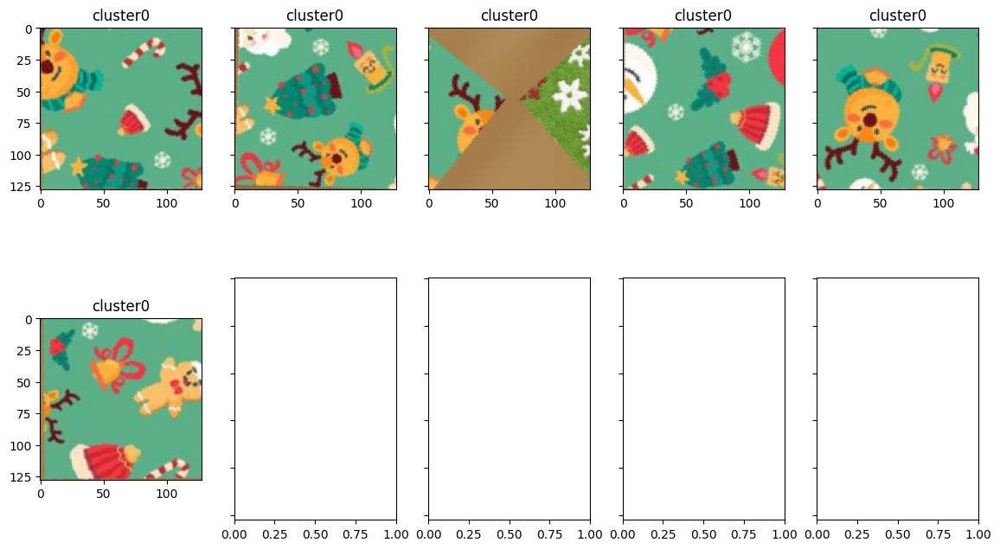

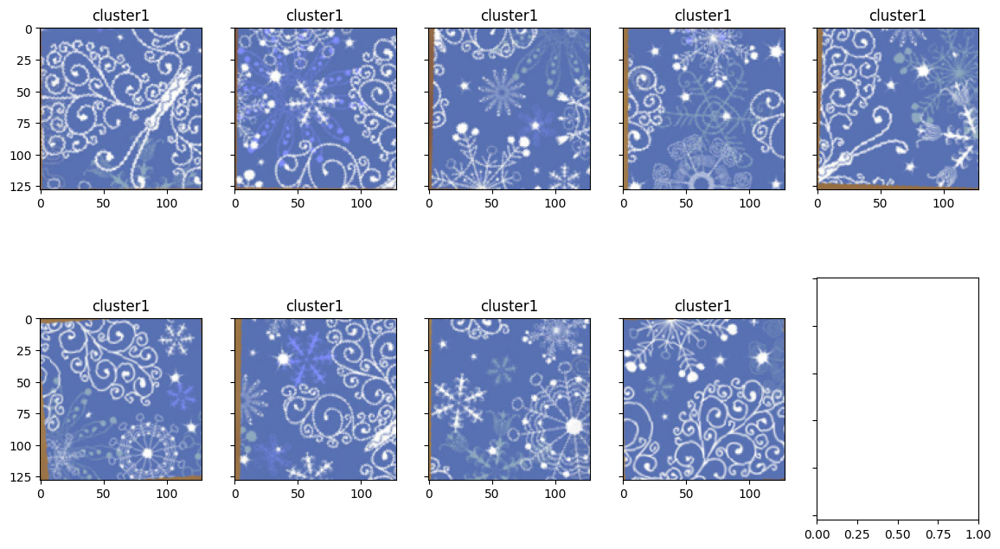

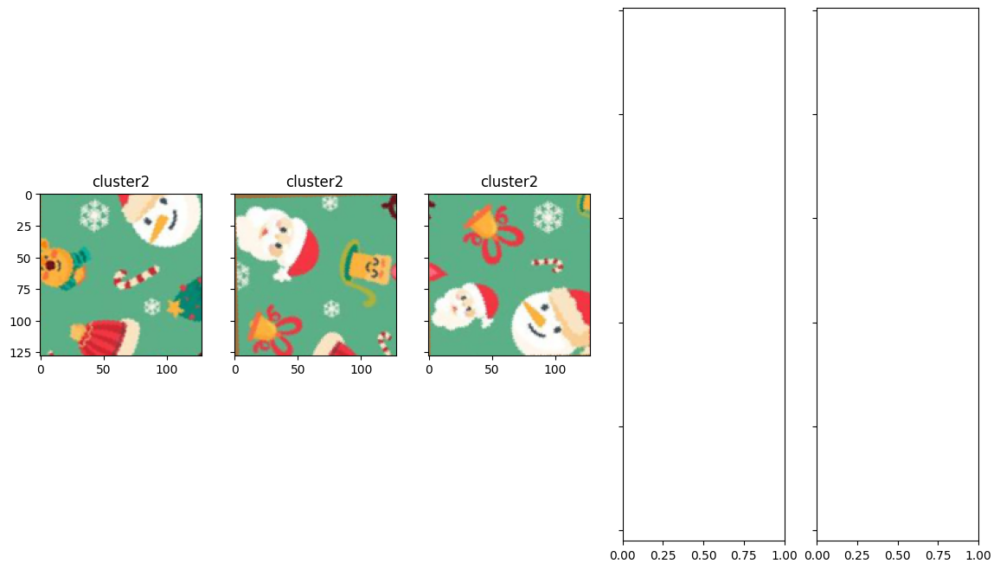

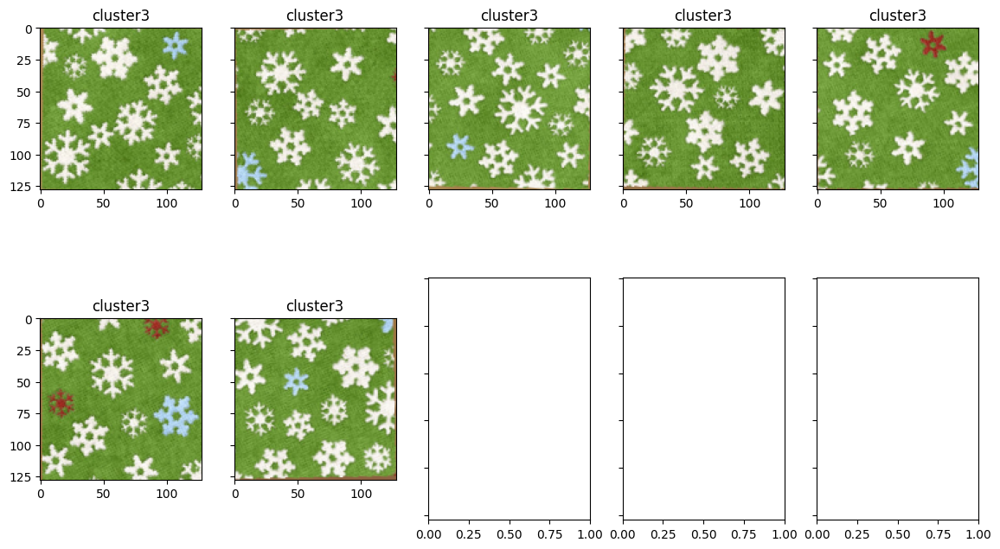

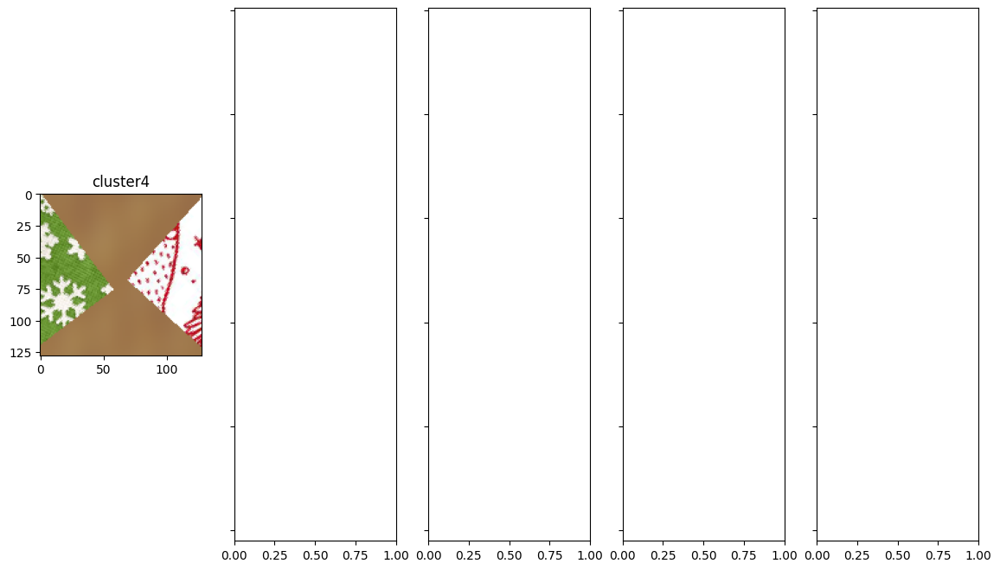

In [109]:
# Plot results
see_clusters_per_image(0)  # CHOOSE IMAGE YOU WANT

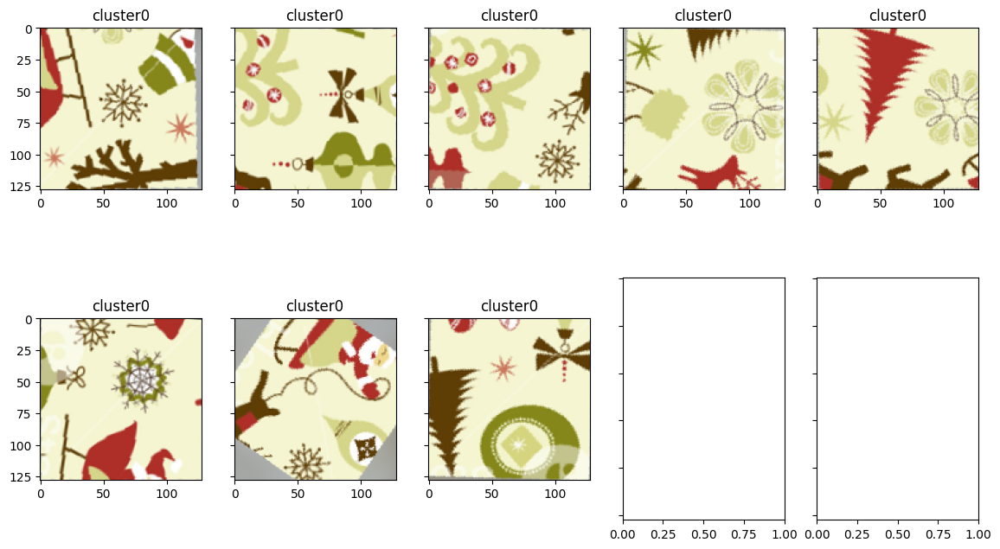

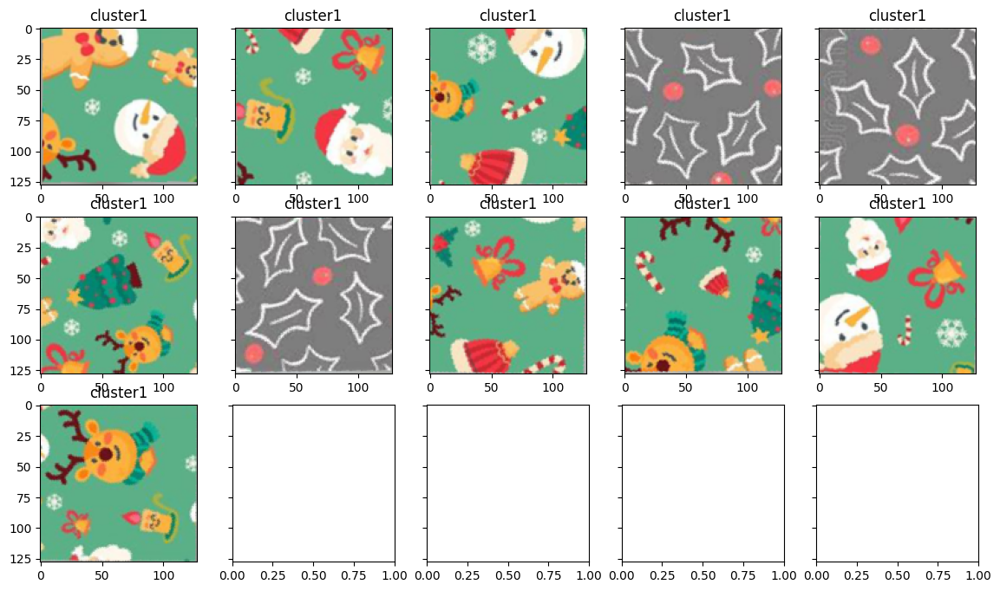

In [110]:
# Plot results
see_clusters_per_image(1)  # CHOOSE IMAGE YOU WANT

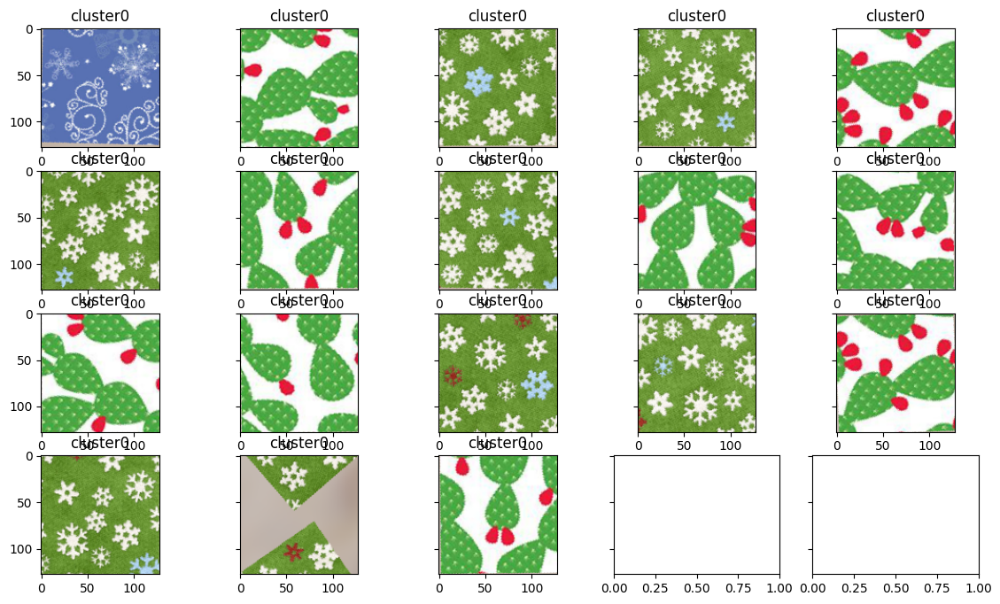

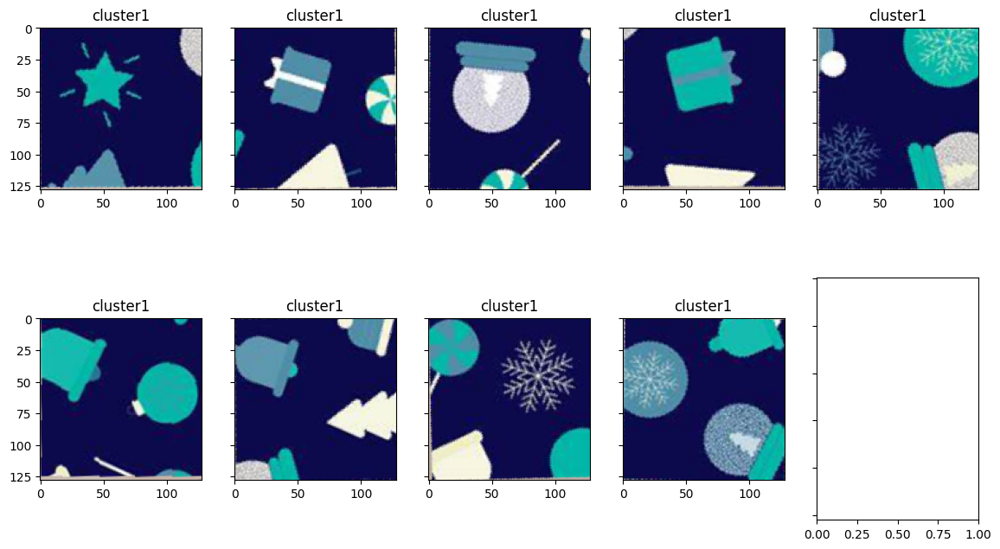

In [111]:
# Plot results
see_clusters_per_image(2)  # CHOOSE IMAGE YOU WANT

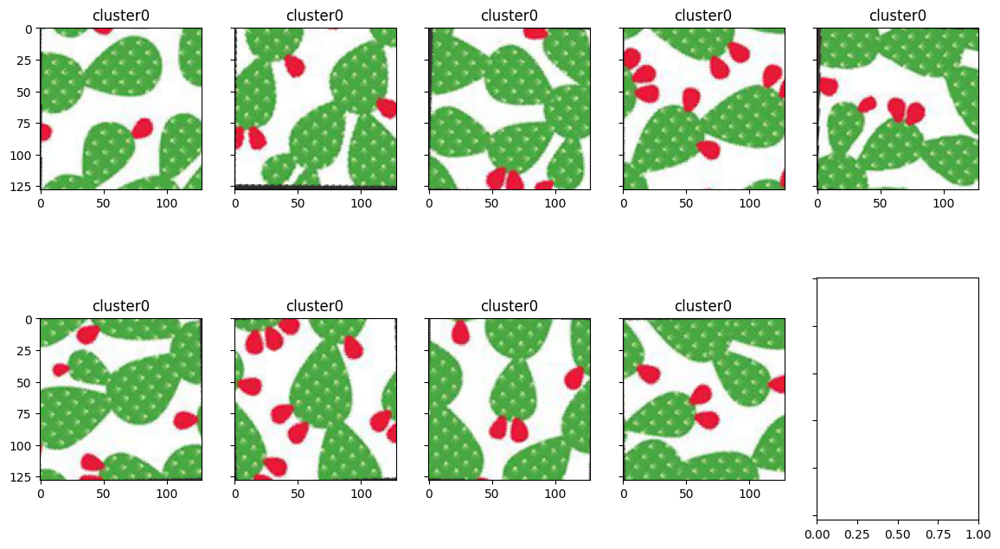

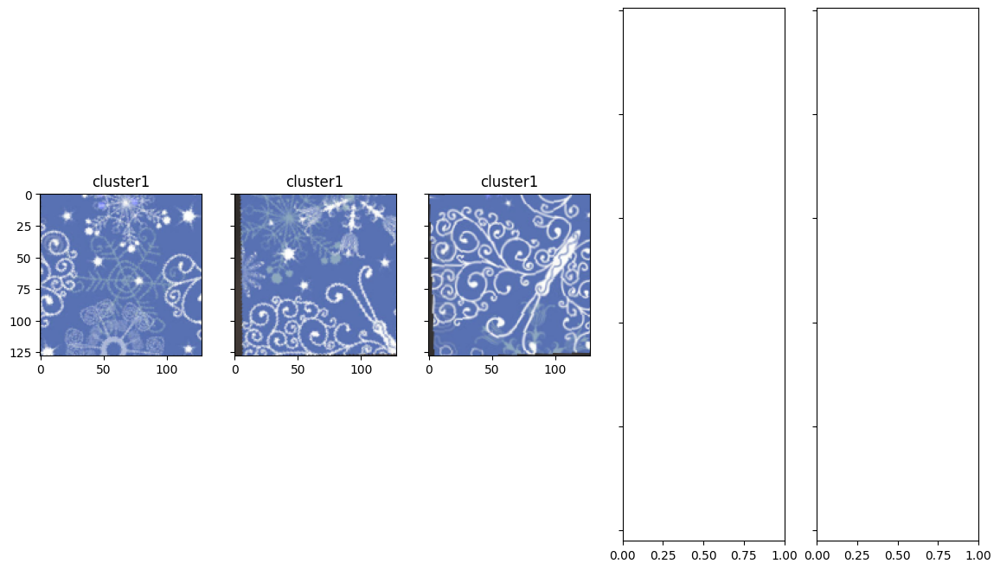

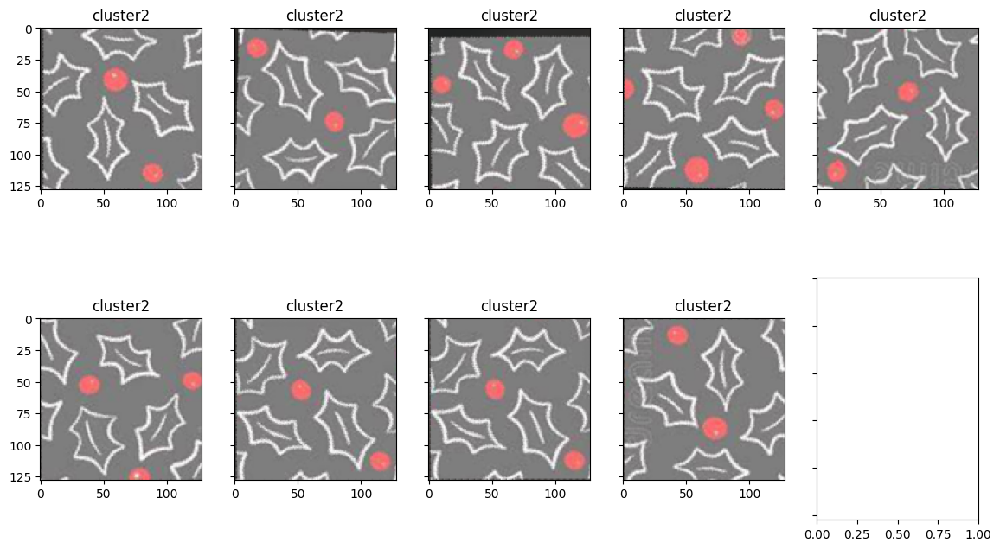

In [112]:
# Plot results
see_clusters_per_image(3)  # CHOOSE IMAGE YOU WANT

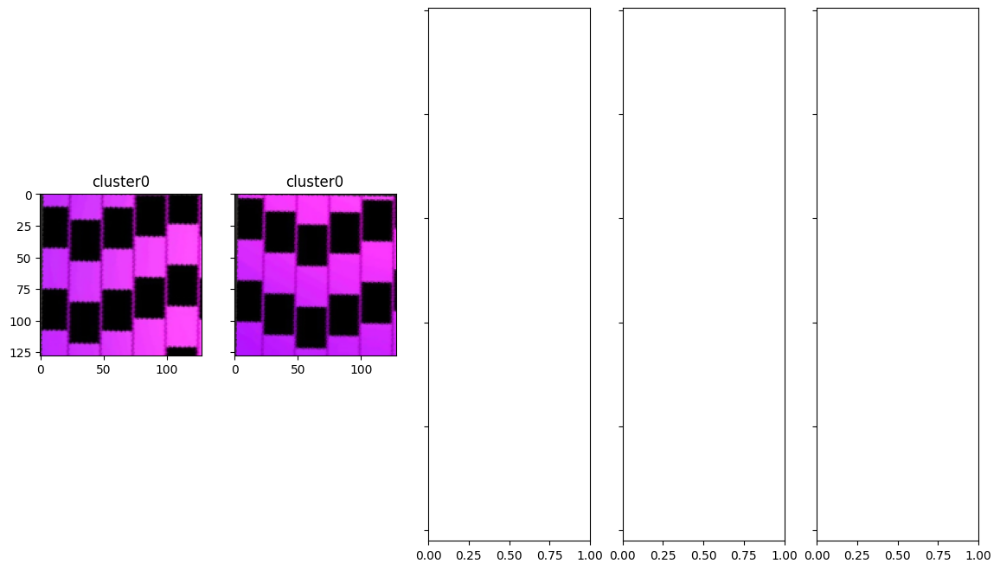

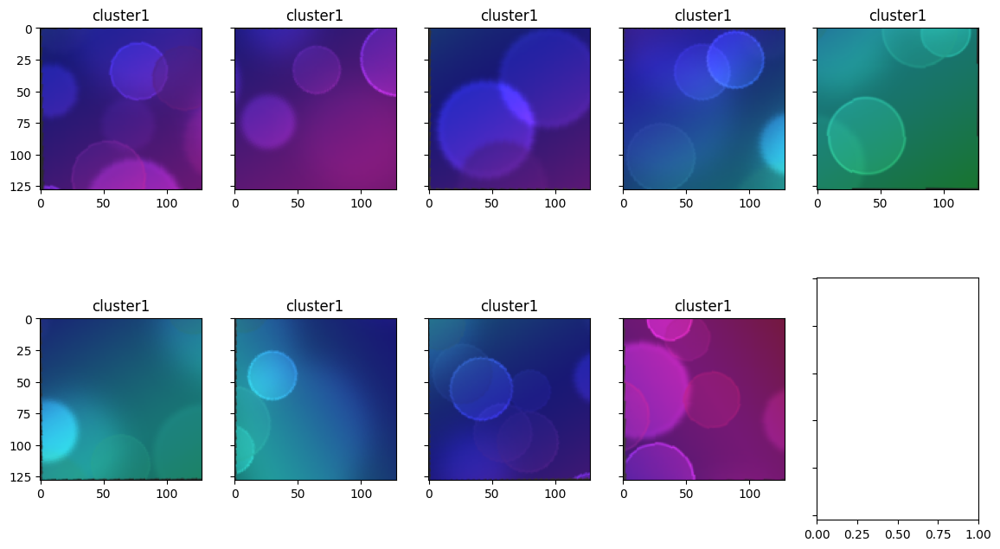

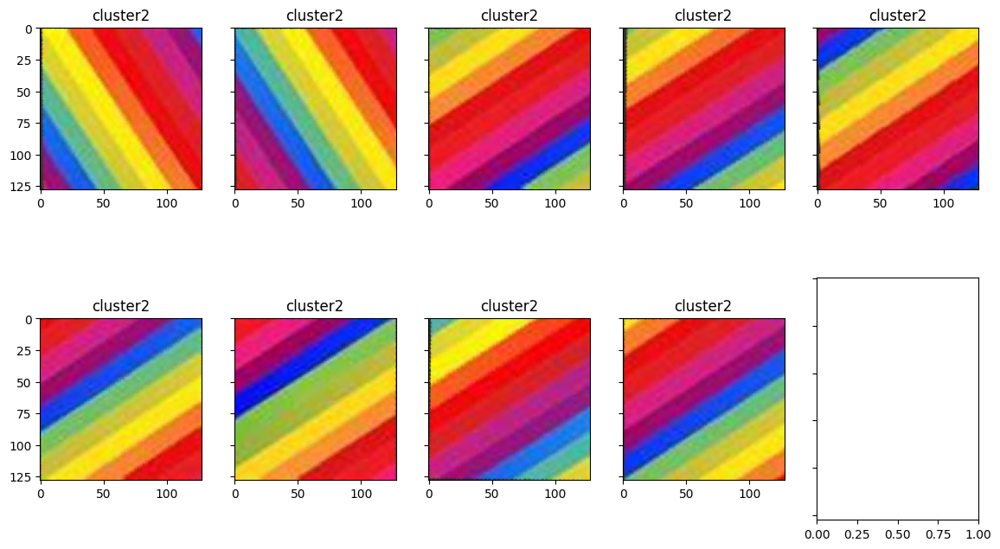

In [113]:
# Plot results
see_clusters_per_image(4)  # CHOOSE IMAGE YOU WANT

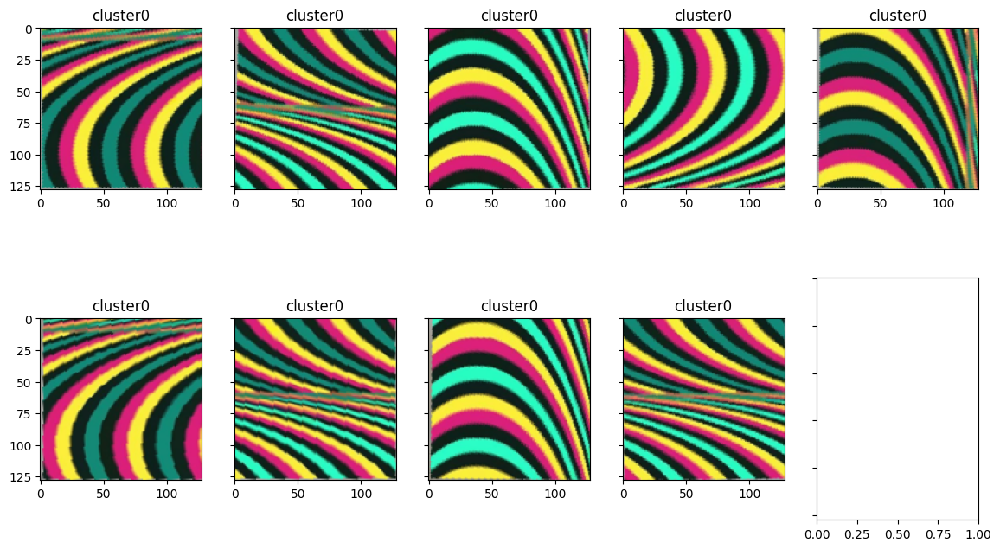

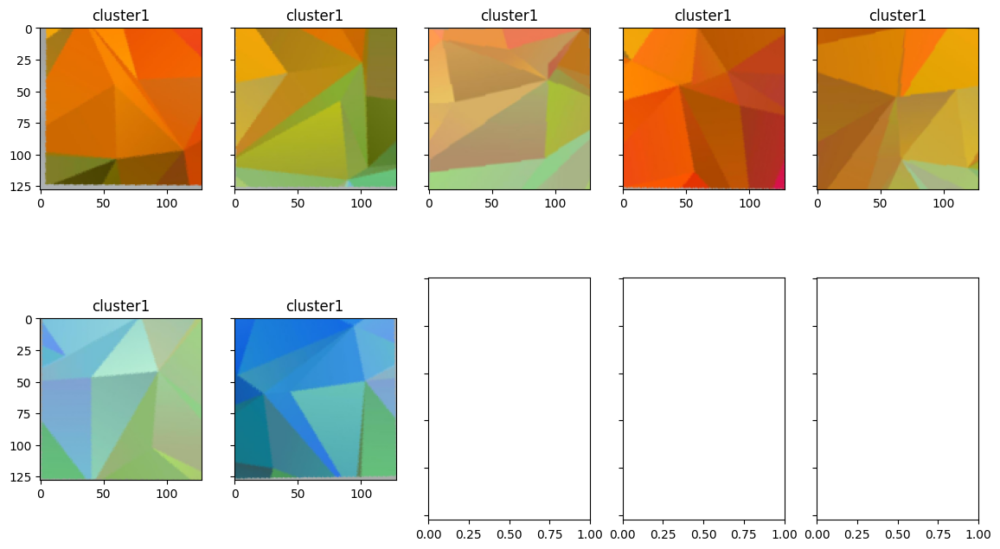

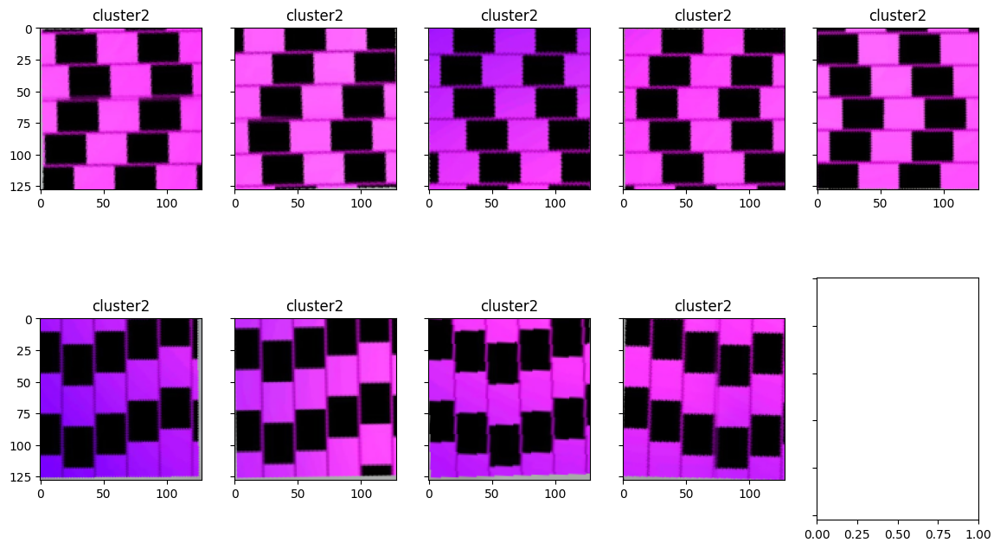

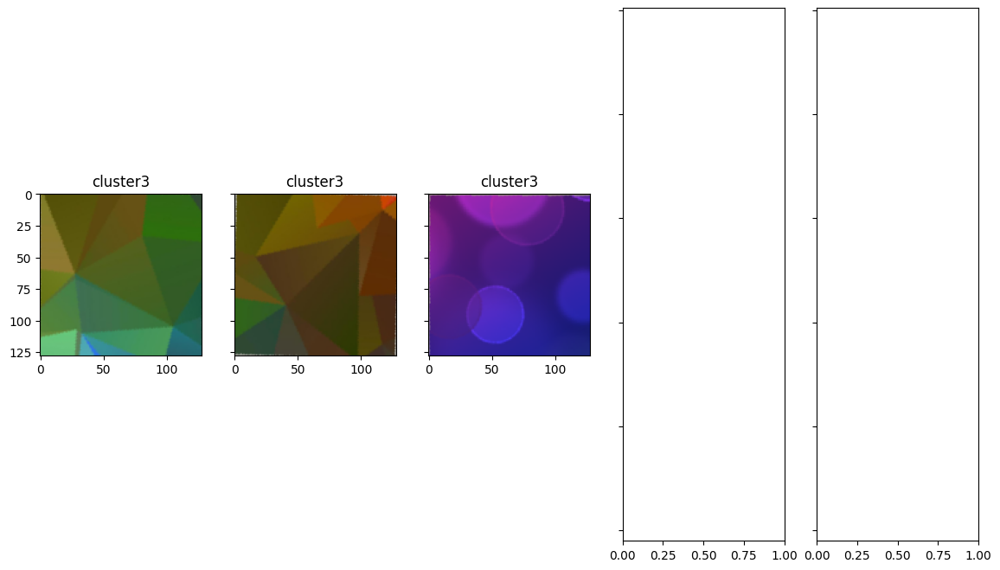

In [114]:
# Plot results
see_clusters_per_image(5)  # CHOOSE IMAGE YOU WANT

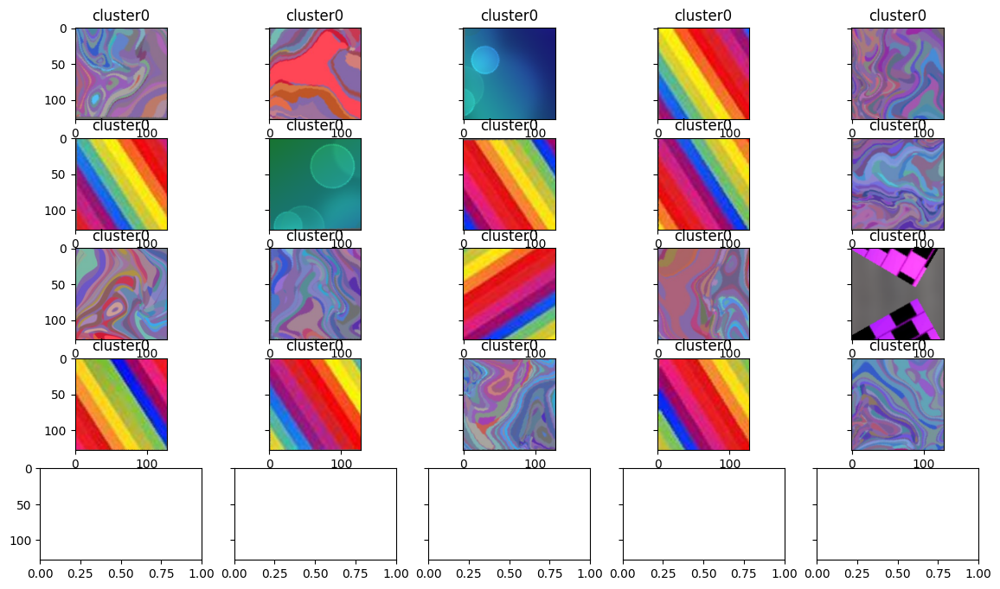

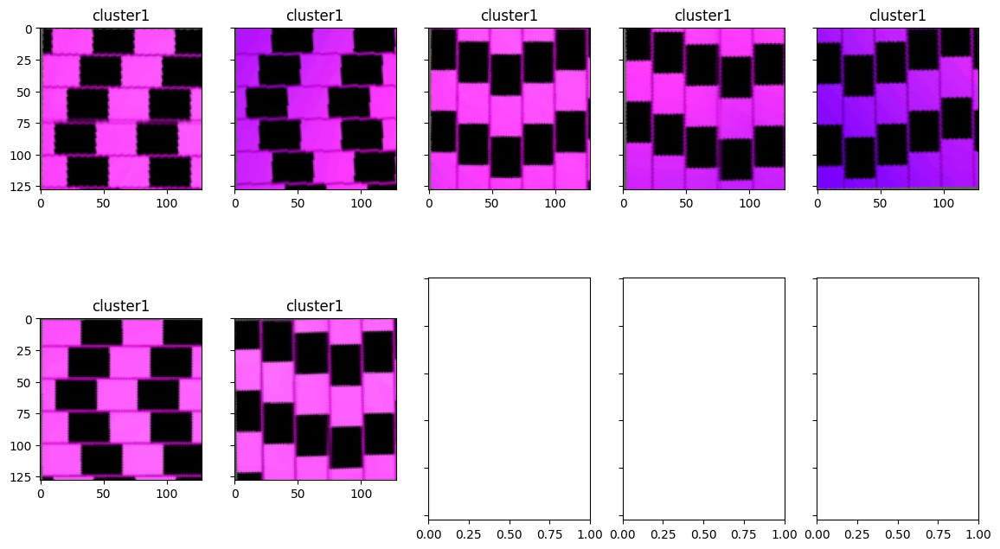

In [115]:
# Plot results
see_clusters_per_image(6)  # CHOOSE IMAGE YOU WANT

### TOSAVE

In [ ]:
def save_solution_puzzles(image_index, solved_puzzles, outliers, folder ="train", path = "data_project", group_id = 0):
    
    path_solution = os.path.join(path, folder + "_solution_{}".format(str(group_id).zfill(2)))
    if not  os.path.isdir(path_solution):
        os.mkdir(path_solution)

    print(path_solution)
    for i, puzzle in enumerate(solved_puzzles):
        filename =os.path.join(path_solution, "solution_{}_{}.png".format(str(image_index).zfill(2), str(i).zfill(2)))
        Image.fromarray(puzzle).save(filename)

    for i , outlier in enumerate(outliers):
        filename =os.path.join(path_solution, "outlier_{}_{}.png".format(str(image_index).zfill(2), str(i).zfill(2)))
        Image.fromarray(outlier).save(filename)

In [ ]:
def solve_and_export_puzzles_image(image_index, folder = "train", path = ROOT_PATH+"/data_project", group_id = "00"):
    """
    Wrapper funciton to load image and save solution
            
    Parameters
    ----------
    image:
        index number of the dataset

    Returns
    """

      # open the image
    image_loaded = load_input_image(image_index , folder = folder , path = path)
    #print(image_loaded)
    
   
    ## call functions to solve image_loaded
    solved_puzzles = [ (np.random.rand(512,512,3)*255).astype(np.uint8)  for i in range(2) ]
    outlier_images = [ (np.random.rand(128,128,3)*255).astype(np.uint8) for i in range(3)]
    
    save_solution_puzzles (image_index , solved_puzzles , outlier_images , folder = folder ,group_id =group_id)
    
   
    
    
    
    return image_loaded , solved_puzzles , outlier_images

im, sol , out = solve_and_export_puzzles_image(6 , group_id = 6)

In [ ]:
group_id = 0
# Evaluate all images
games_id = [6,10]  # to evaluate  three images

for i in games_id :
    
    print("solving " , i)
    # Saving results
    solve_and_export_puzzles_image(6 , group_id = group_id)

## Evaluation metrics

The evaluation metrics will be liberated in the following days. 


## Gabor filters

$$ gb(x,y) = \exp \left( -\frac{1}{2} \left( \frac{x_{\theta}^2}{\sigma^2} + \frac{y_{\theta}^2}{(\Gamma\sigma)^2} \right) \right) \cos \left( \frac{2 \pi}{\lambda} x_{\theta} + \psi \right) $$
